In [19]:
import glob
for path in glob.glob("**/data.mat", recursive=True):
    print(path)


exp/datasets/anes_data/simu/1/data.mat
exp/datasets/anes_data/simu/2/data.mat
exp/datasets/anes_data/simu/3/data.mat
exp/datasets/anes_data/simu/4/data.mat
exp/datasets/anes_data/vivo/data.mat


In [20]:
# Define a reusable function to convert RF to B-mode and match bmode_GT
def rf_to_matched_bmode(RF: np.ndarray, GT_bmode: np.ndarray, increase: float = 1e-6) -> np.ndarray:
    """
    Convert RF data to B-mode and match the intensity profile to the provided ground truth B-mode image.
    
    Parameters
    ----------
    RF : np.ndarray
        3D RF data with shape (H, W, N), where N is the number of frames.
    GT_bmode : np.ndarray
        Ground truth B-mode image for histogram matching (should match shape (H, W)).
    increase : float
        Small constant to avoid log(0), used during envelope detection and log compression.

    Returns
    -------
    np.ndarray
        Histogram-matched B-mode image (uint8) with shape (H, W, N).
    """
    import numpy as np
    from scipy.signal import hilbert
    from skimage.exposure import match_histograms

    if RF.ndim != 3:
        raise ValueError("RF must be a 3D array (H, W, Nframes).")

    if not np.issubdtype(RF.dtype, np.floating):
        RF = RF.astype(np.float32)

    H, W, N = RF.shape
    modeB = np.empty((H, W, N), dtype=np.uint8)

    for i in range(N):
        # Envelope detection
        env = np.abs(hilbert(RF[:, :, i], axis=0))

        # Log compression (log10)
        modeB_temp = 20.0 * np.log10(env + increase)
        modeB_temp = np.clip(modeB_temp, a_min=-60, a_max=None)

        # Normalize to 0–255
        modeB_temp -= modeB_temp.min()
        max_val = modeB_temp.max()
        if max_val > 0:
            modeB_temp = 255.0 * modeB_temp / max_val

        # Histogram match to GT
        matched = match_histograms(modeB_temp, GT_bmode[:, :, 0] if GT_bmode.ndim == 3 else GT_bmode, channel_axis=None)
        modeB[:, :, i] = np.clip(matched, 0, 255).astype(np.uint8)

    return modeB



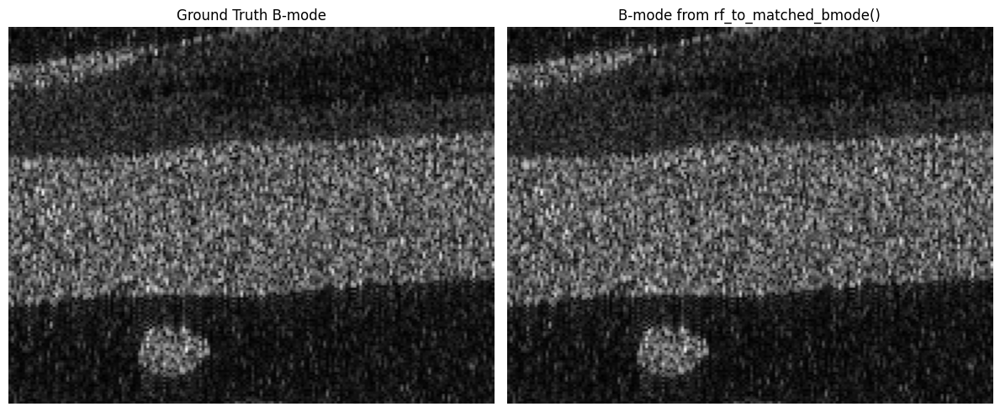

In [21]:
import numpy as np
import scipy.io
import matplotlib.pyplot as plt
from rf_to_matched_bmode import rf_to_matched_bmode  # Your saved function

# Load the dataset
mat_path = "exp/datasets/anes_data/simu/1/data.mat"
data = scipy.io.loadmat(mat_path)

# Extract GT_rf and bmode_GT
GT_rf = data['GT_rf']
bmode_GT = data['bmode_GT']

# Ensure GT_rf is 3D
if GT_rf.ndim == 2:
    GT_rf = GT_rf[:, :, np.newaxis]

# Run the RF to B-mode conversion with histogram matching
matched_bmode = rf_to_matched_bmode(GT_rf, bmode_GT)

# Prepare both images for display (take the first frame only)
matched_image = matched_bmode[:, :, 0]
ground_truth_image = bmode_GT[:, :, 0] if bmode_GT.ndim == 3 else bmode_GT

# Plot side-by-side comparison
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.imshow(ground_truth_image, cmap='gray', aspect='auto')
plt.title("Ground Truth B-mode")
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(matched_image, cmap='gray', aspect='auto')
plt.title("B-mode from rf_to_matched_bmode()")
plt.axis('off')

plt.tight_layout()
plt.show()


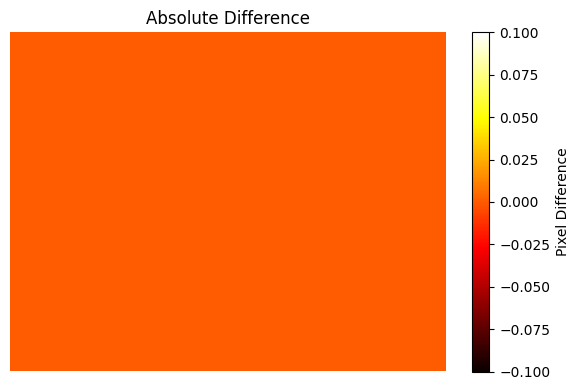

In [22]:
diff = np.abs(matched_image.astype(int) - ground_truth_image.astype(int))

plt.figure(figsize=(6, 4))
plt.imshow(diff, cmap='hot', aspect='auto')
plt.title("Absolute Difference")
plt.colorbar(label="Pixel Difference")
plt.axis("off")
plt.tight_layout()
plt.show()


In [23]:
import numpy as np
np.max(diff)

0

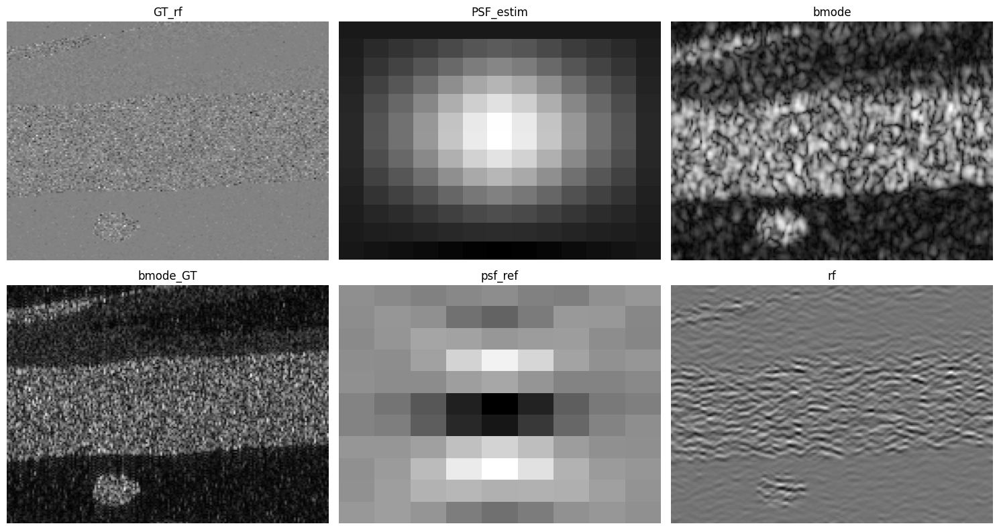

In [24]:
import numpy as np
import matplotlib.pyplot as plt
import scipy.io

# Load .mat file
mat_path = "exp/datasets/anes_data/simu/1/data.mat"
mat_data = scipy.io.loadmat(mat_path)

# Variables to visualize (6 in total)
variables_to_plot = ['GT_rf', 'PSF_estim', 'bmode', 'bmode_GT', 'psf_ref', 'rf']

# Create 2 rows and 3 columns subplot
fig, axes = plt.subplots(2, 3, figsize=(15, 8))
axes = axes.flatten()  # Flatten for easy indexing

for i, var in enumerate(variables_to_plot):
    if var not in mat_data:
        axes[i].set_title(f"{var} (Not Found)")
        axes[i].axis('off')
        continue

    data = mat_data[var]
    img = data[:, :, 0] if data.ndim == 3 else data

    axes[i].imshow(img, cmap='gray', aspect='auto')
    axes[i].set_title(var)
    axes[i].axis('off')

plt.tight_layout()
plt.show()


In [26]:
!python main_mat_ddrm.py \
  --mat_dir exp/datasets/anes_data/simu/1 \
  --mat_list exp/datasets/anes_data/simu/1/mat_list.txt \
  --key GT_rf \
  --image_size 256 \
  --psf_path psf_GT_1.mat \
  --model_path exp/logs/imagenet/256x256_diffusion_uncond.pt \
  --timesteps 20 \
  --eta 0.85 \
  --etaB 1.0 \
  --deg deblur_bccb \
  --sigma_0 0 \
  --output_dir mat_output_ddrm \
  --config deblur_us.yml \
  --doc 1


Module path: /projects/minds/PDAS-M2-2025/DDPM
Current sys.path: ['/projects/minds/PDAS-M2-2025/MIRDDRM', '/usr/lib/python310.zip', '/usr/lib/python3.10', '/usr/lib/python3.10/lib-dynload', '/home/pdas/.local/lib/python3.10/site-packages', '/usr/local/lib/python3.10/dist-packages', '/usr/local/lib/python3.10/dist-packages/nvfuser-0.1.4a0+d0bb811-py3.10-linux-x86_64.egg', '/usr/lib/python3/dist-packages', '/projects/minds/PDAS-M2-2025/DDPM']
File not found: /projects/minds/PDAS-M2-2025/DDPM/denoising_diffusion_pytorch.py
Import failed: No module named 'denoising_diffusion_pytorch'
INFO:root:Using device: cuda
INFO:root:Using device: cuda
INFO - main.py - 2025-05-14 11:18:45,377 - Using device: cuda
INFO:root:✅ Model instantiated and checkpoint loaded.
INFO - main_mat_ddrm.py - 2025-05-14 11:18:51,732 - ✅ Model instantiated and checkpoint loaded.
INFO:root:Loading PSF from: psf_GT_1.mat
INFO - main_mat_ddrm.py - 2025-05-14 11:18:51,732 - Loading PSF from: psf_GT_1.mat
INFO:root:✅ Found P

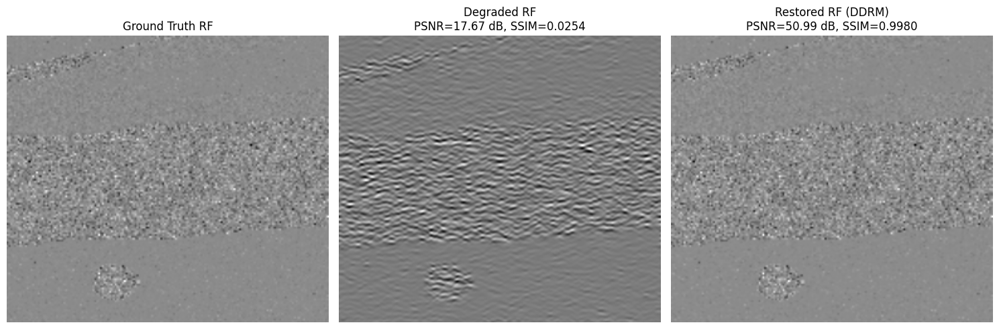

In [28]:
import scipy.io
import matplotlib.pyplot as plt
import numpy as np
import os
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim

# Load .mat files
output_dir = "mat_output_ddrm"
gt_rf = scipy.io.loadmat(os.path.join(output_dir, 'ground_truth.mat'))
degraded_rf = scipy.io.loadmat(os.path.join(output_dir, 'degraded_y0.mat'))
restored_rf = scipy.io.loadmat(os.path.join(output_dir, 'restored_ddrm.mat'))

# Extract the actual data arrays (ignoring __header__, __version__, etc.)
def extract_main(data):
    for k, v in data.items():
        if not k.startswith('__'):
            return v
gt = extract_main(gt_rf)
degraded = extract_main(degraded_rf)
restored = extract_main(restored_rf)

# Ensure 2D slices for PSNR/SSIM and visualization
gt_img = gt[:, :, 0] if gt.ndim == 3 else gt
degraded_img = degraded[:, :, 0] if degraded.ndim == 3 else degraded
restored_img = restored[:, :, 0] if restored.ndim == 3 else restored

# Normalize to [0, 1] for fair SSIM comparison
def normalize(img):
    return (img - img.min()) / (img.max() - img.min() + 1e-8)

gt_n = normalize(gt_img)
degraded_n = normalize(degraded_img)
restored_n = normalize(restored_img)

# Compute PSNR and SSIM
psnr_deg = psnr(gt_n, degraded_n, data_range=1.0)
ssim_deg = ssim(gt_n, degraded_n, data_range=1.0)

psnr_res = psnr(gt_n, restored_n, data_range=1.0)
ssim_res = ssim(gt_n, restored_n, data_range=1.0)

# Plotting
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
images = [gt_img, degraded_img, restored_img]
titles = [
    "Ground Truth RF",
    f"Degraded RF\nPSNR={psnr_deg:.2f} dB, SSIM={ssim_deg:.4f}",
    f"Restored RF (DDRM)\nPSNR={psnr_res:.2f} dB, SSIM={ssim_res:.4f}"
]

for ax, img, title in zip(axes, images, titles):
    ax.imshow(img, cmap='gray', aspect='auto')
    ax.set_title(title)
    ax.axis('off')

plt.tight_layout()
plt.show()


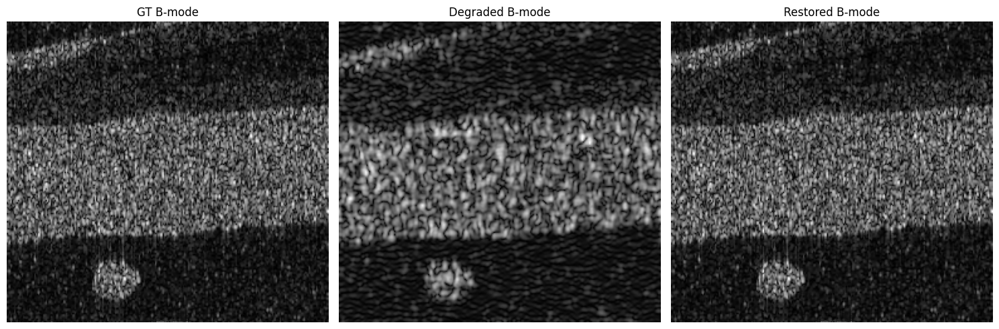

In [29]:
import numpy as np
import scipy.io
import matplotlib.pyplot as plt
from scipy.signal import hilbert
from skimage.exposure import match_histograms

# --------------------------------------
# Define reusable B-mode conversion + matching
# --------------------------------------
def rf_to_matched_bmode(RF: np.ndarray, GT_bmode: np.ndarray, increase: float = 1e-6) -> np.ndarray:
    env = np.abs(hilbert(RF, axis=0))
    db  = 20.0 * np.log10(env + increase)
    db  = np.clip(db, a_min=-60, a_max=None)
    db -= db.min()
    db *= (255.0 / db.max())
    ref = GT_bmode[:, :, 0] if GT_bmode.ndim == 3 else GT_bmode
    matched = match_histograms(db, ref, channel_axis=None)
    return np.clip(matched, 0, 255).astype(np.uint8)

# --------------------------------------
# Load RF data
# --------------------------------------
gt_mat     = scipy.io.loadmat("mat_output_ddrm/ground_truth.mat")
deg_mat    = scipy.io.loadmat("mat_output_ddrm/degraded_y0.mat")
res_mat    = scipy.io.loadmat("mat_output_ddrm/restored_ddrm.mat")

rf_gt      = gt_mat["GT_rf_resized"]
rf_degraded= deg_mat["rf_degraded"]
rf_restored= res_mat["rf_restored"]

# --------------------------------------
# Load Simu-1 ground-truth B-mode
# --------------------------------------
sim1       = scipy.io.loadmat("exp/datasets/anes_data/simu/1/data.mat")
bmode_GT   = sim1["bmode_GT"]

# --------------------------------------
# Match RF→RF and convert to B-mode
# --------------------------------------
rf_deg_matched = match_histograms(rf_degraded, rf_gt, channel_axis=None)
rf_res_matched = match_histograms(rf_restored, rf_gt, channel_axis=None)

bmode_gt_image       = rf_to_matched_bmode(rf_gt,        bmode_GT)
bmode_degraded_image = rf_to_matched_bmode(rf_deg_matched, bmode_GT)
bmode_restored_image = rf_to_matched_bmode(rf_res_matched, bmode_GT)

# --------------------------------------
# Plot side-by-side and save PNG
# --------------------------------------
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
axes[0].imshow(bmode_gt_image,       cmap='gray', aspect='auto'); axes[0].axis('off'); axes[0].set_title("GT B-mode")
axes[1].imshow(bmode_degraded_image, cmap='gray', aspect='auto'); axes[1].axis('off'); axes[1].set_title("Degraded B-mode")
axes[2].imshow(bmode_restored_image, cmap='gray', aspect='auto'); axes[2].axis('off'); axes[2].set_title("Restored B-mode")
plt.tight_layout()
plt.savefig("mat_output_rf/bmode_comparison.png", dpi=300, bbox_inches='tight')

# --------------------------------------
# Save individual B-mode images to .mat
# --------------------------------------
scipy.io.savemat("mat_output_rf/bmode_degraded.mat", {"bmode_degraded": bmode_degraded_image})
scipy.io.savemat("mat_output_rf/bmode_restored.mat", {"bmode_restored": bmode_restored_image})


In [1]:
!python apply_degradation.py \
  --mat_dir  exp/datasets/anes_data/simu/1 \
  --mat_list exp/datasets/anes_data/simu/1/mat_list.txt \
  --key      GT_rf \
  --psf_path exp/datasets/anes_data/simu/1/psf_GT_1.mat \
  --image_size 256 \
  --sigma_0 0 \
  --output_dir mat_Degradation


Using device: cuda
✅ Found PSF key: psf_ref
✅ Saved:
   • ground_truth.mat   (GT_rf_resized)
   • degraded_y0.mat    (rf_degraded)


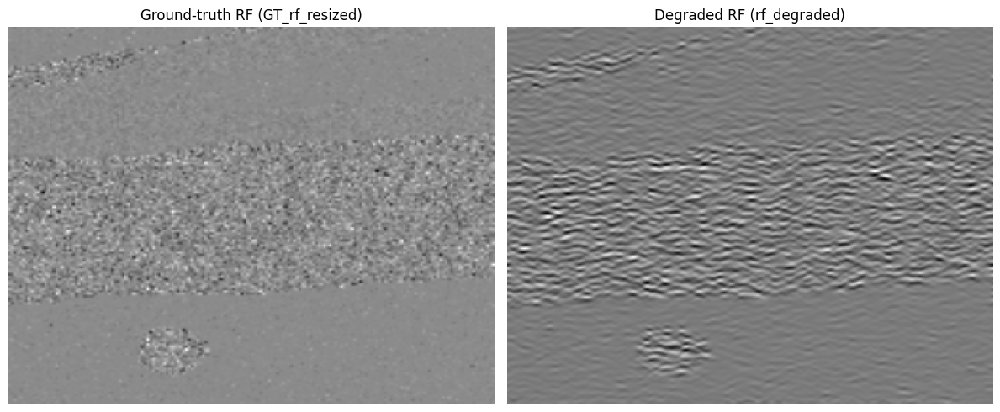

In [2]:
import scipy.io
import matplotlib.pyplot as plt
import numpy as np
import os

# ------------------------------------------------------------------
# 1.  Paths to the new .mat files
# ------------------------------------------------------------------
root_dir = "mat_Degradation"          # folder you chose when running apply_degradation.py
gt_path  = os.path.join(root_dir, "ground_truth.mat")
deg_path = os.path.join(root_dir, "degraded_y0.mat")

# ------------------------------------------------------------------
# 2.  Helper: load one variable from .mat
# ------------------------------------------------------------------
def load_var(mat_file, key):
    mat = scipy.io.loadmat(mat_file)
    if key not in mat:
        raise KeyError(f"'{key}' not found in {mat_file}")
    arr = mat[key]
    # if it ended up being 3-D (H, W, 1), squeeze to 2-D for display
    return arr.squeeze()

# ------------------------------------------------------------------
# 3.  Load arrays
# ------------------------------------------------------------------
gt_rf   = load_var(gt_path,  "GT_rf_resized")
deg_rf  = load_var(deg_path, "rf_degraded")

# ------------------------------------------------------------------
# 4.  Normalise to [0,1] for fair visual contrast
# ------------------------------------------------------------------
def normalise(img):
    img = img.astype(np.float32)
    img -= img.min()
    img /= (img.max() - img.min() + 1e-8)
    return img

gt_vis  = normalise(gt_rf)
deg_vis = normalise(deg_rf)

# ------------------------------------------------------------------
# 5.  Plot
# ------------------------------------------------------------------
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.imshow(gt_vis, cmap="gray", aspect="auto")
plt.title("Ground-truth RF (GT_rf_resized)")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(deg_vis, cmap="gray", aspect="auto")
plt.title("Degraded RF (rf_degraded)")
plt.axis("off")

plt.tight_layout()
plt.show()


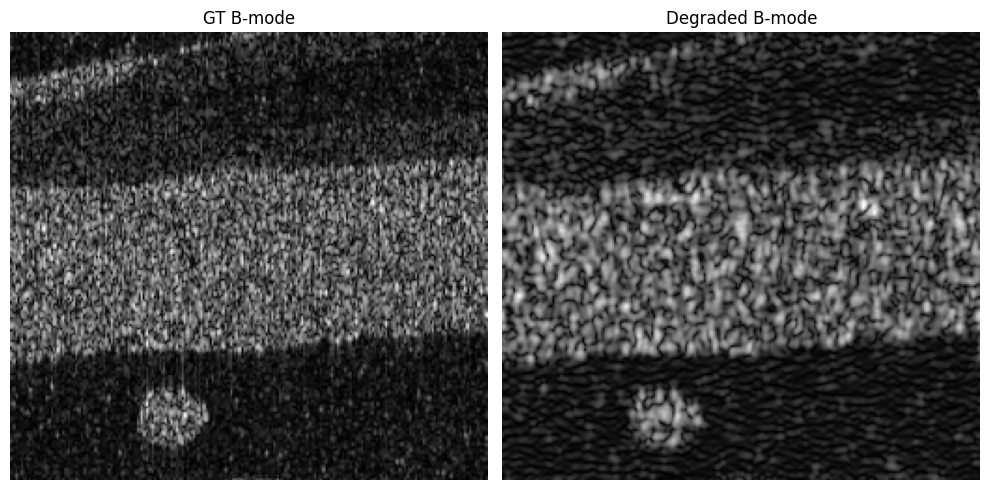

In [4]:
import numpy as np
import scipy.io
import matplotlib.pyplot as plt
from scipy.signal import hilbert
from skimage.exposure import match_histograms
import os

# --------------------------------------
# ✅ Define B-mode conversion with histogram matching
# --------------------------------------
def rf_to_matched_bmode(RF: np.ndarray, GT_bmode: np.ndarray, increase: float = 1e-6) -> np.ndarray:
    env = np.abs(hilbert(RF, axis=0))
    db  = 20.0 * np.log10(env + increase)
    db  = np.clip(db, a_min=-60, a_max=None)
    db -= db.min()
    db *= (255.0 / db.max())
    ref = GT_bmode[:, :, 0] if GT_bmode.ndim == 3 else GT_bmode
    matched = match_histograms(db, ref, channel_axis=None)
    return np.clip(matched, 0, 255).astype(np.uint8)

# --------------------------------------
# ✅ Load degraded RF and GT data
# --------------------------------------
deg_mat     = scipy.io.loadmat("mat_Degradation/degraded_y0.mat")
gt_mat      = scipy.io.loadmat("mat_Degradation/ground_truth.mat")
# Use 'GT_rf_resized' as in your earlier pipeline
rf_degraded = deg_mat["rf_degraded"]
rf_gt       = gt_mat["GT_rf_resized"]

# ✅ Load ground-truth B-mode (for histogram matching)
sim1_mat    = scipy.io.loadmat("exp/datasets/anes_data/simu/1/data.mat")
bmode_GT    = sim1_mat["bmode_GT"]

# --------------------------------------
# ✅ Match RF dynamic range + convert to B-mode
# --------------------------------------
# Match degraded RF histogram to GT RF for fairer dynamic range
rf_deg_matched = match_histograms(rf_degraded, rf_gt, channel_axis=None)

# Convert to B-mode, matching histogram to GT B-mode for visual fairness
bmode_degraded = rf_to_matched_bmode(rf_deg_matched, bmode_GT)
bmode_gt       = rf_to_matched_bmode(rf_gt, bmode_GT)

# --------------------------------------
# ✅ Plot and save comparison
# --------------------------------------
os.makedirs("mat_Degradation", exist_ok=True)

fig, axes = plt.subplots(1, 2, figsize=(10, 5))
axes[0].imshow(bmode_gt, cmap='gray', aspect='auto')
axes[0].axis('off')
axes[0].set_title("GT B-mode")
axes[1].imshow(bmode_degraded, cmap='gray', aspect='auto')
axes[1].axis('off')
axes[1].set_title("Degraded B-mode")
plt.tight_layout()
plt.savefig("mat_Degradation/bmode_gt_vs_degraded.png", dpi=300, bbox_inches='tight')
plt.show()

# --------------------------------------
# ✅ Save B-mode degraded as .mat
# --------------------------------------
scipy.io.savemat("mat_Degradation/bmode_degraded.mat", {"bmode_degraded": bmode_degraded})


In [5]:
!python run_ddrm_restoration.py \
  --degraded_mat  mat_Degradation/degraded_y0.mat \
  --gt_mat        mat_Degradation/ground_truth.mat \
  --psf_path      exp/datasets/anes_data/simu/1/psf_GT_1.mat \
  --model_path    exp/logs/imagenet/256x256_diffusion_uncond.pt \
  --config        deblur_us.yml \
  --timesteps     20 --eta 0.85 --etaB 1.0 \
  --output_dir    mat_Restore_DDRM


Module path: /projects/minds/PDAS-M2-2025/DDPM
Current sys.path: ['/projects/minds/PDAS-M2-2025/MIRDDRM', '/usr/lib/python310.zip', '/usr/lib/python3.10', '/usr/lib/python3.10/lib-dynload', '/home/pdas/.local/lib/python3.10/site-packages', '/usr/local/lib/python3.10/dist-packages', '/usr/local/lib/python3.10/dist-packages/nvfuser-0.1.4a0+d0bb811-py3.10-linux-x86_64.egg', '/usr/lib/python3/dist-packages', '/projects/minds/PDAS-M2-2025/DDPM']
File not found: /projects/minds/PDAS-M2-2025/DDPM/denoising_diffusion_pytorch.py
Import failed: No module named 'denoising_diffusion_pytorch'
Using device: cuda
✅ PSF loaded (key='psf_ref', shape=(11, 9))
INFO - main.py - 2025-05-16 14:39:35,078 - Using device: cuda
✅ Model checkpoint loaded
20it [00:14,  1.43it/s]
✅ Saved mat_Restore_DDRM/restored_ddrm.mat
PSNR: 50.35 dB   SSIM: 0.9969


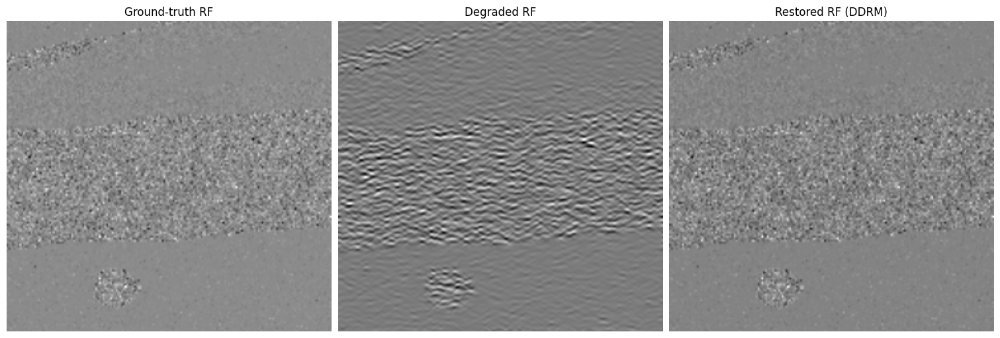

In [8]:
import scipy.io
import numpy as np
import matplotlib.pyplot as plt

# -----------------------------
# 1. Load all RF arrays
# -----------------------------
gt_rf = scipy.io.loadmat("mat_Degradation/ground_truth.mat")["GT_rf_resized"]
deg_rf = scipy.io.loadmat("mat_Degradation/degraded_y0.mat")["rf_degraded"]
rest_rf = scipy.io.loadmat("mat_Restore_DDRM/restored_ddrm.mat")["rf_restored"]

# -----------------------------
# 2. Normalization function for fair visualization
# -----------------------------
def normalize(img):
    img = img.astype(np.float32)
    img -= img.min()
    img /= (img.max() - img.min() + 1e-8)
    return img

gt_vis = normalize(gt_rf)
deg_vis = normalize(deg_rf)
rest_vis = normalize(rest_rf)

# -----------------------------
# 3. Plot all RFs (no colorbar)
# -----------------------------
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
titles = [
    "Ground-truth RF",
    "Degraded RF",
    "Restored RF (DDRM)"
]

for ax, data, title in zip(axes, [gt_vis, deg_vis, rest_vis], titles):
    ax.imshow(data, cmap="gray", aspect="auto")
    ax.set_title(title)
    ax.axis("off")

plt.savefig("mat_Restore_DDRM/rf_comparison.png", dpi=300, bbox_inches="tight")
plt.show()


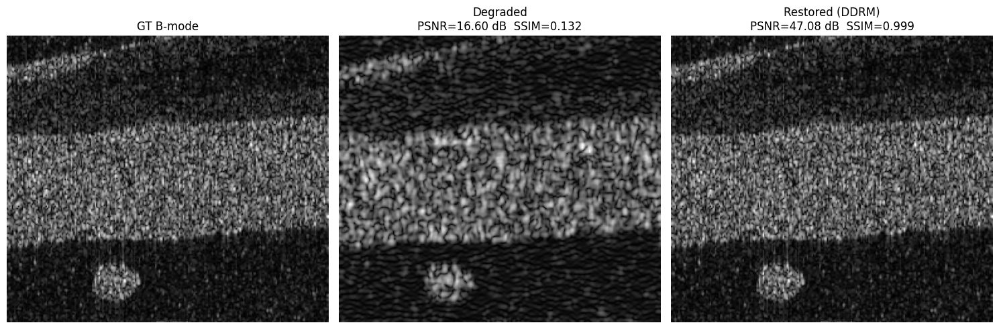

✅ B-mode images & comparison figure saved to mat_Restore_DDRM/


In [9]:
import numpy as np
import scipy.io
import matplotlib.pyplot as plt
from scipy.signal import hilbert
from skimage.exposure import match_histograms
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim
from pathlib import Path

# ---------------------------------------------------------------------
# 1. Reusable RF → B-mode converter that can skip / apply hist-matching
# ---------------------------------------------------------------------
def rf_to_bmode(
    rf: np.ndarray,
    ref_bmode: np.ndarray | None = None,
    dr_db: float = 60.0,
    eps: float = 1e-6,
) -> np.ndarray:
    """
    Convert RF → B-mode (uint8, 0-255). If ref_bmode is supplied,
    histogram-match the output to its intensity profile.
    """
    env = np.abs(hilbert(rf, axis=0))
    log = 20.0 * np.log10(env + eps)
    log = np.clip(log, -dr_db, None)

    # normalise to 0-255
    log -= log.min()
    log *= 255.0 / (log.max() + eps)

    if ref_bmode is not None:
        ref = ref_bmode[..., 0] if ref_bmode.ndim == 3 else ref_bmode
        log = match_histograms(log, ref, channel_axis=None)

    return np.clip(log, 0, 255).astype(np.uint8)


# ---------------------------------------------------------------------
# 2. Load the three RF images (GT, degraded, restored)
# ---------------------------------------------------------------------
paths = {
    "gt":        Path("mat_Degradation/ground_truth.mat"),
    "degraded":  Path("mat_Degradation/degraded_y0.mat"),
    "restored":  Path("mat_Restore_DDRM/restored_ddrm.mat"),
}

rf_gt        = scipy.io.loadmat(paths["gt"])       .get("GT_rf_resized")
rf_degraded  = scipy.io.loadmat(paths["degraded"]) .get("rf_degraded")
rf_restored  = scipy.io.loadmat(paths["restored"]) .get("rf_restored")

# ---------------------------------------------------------------------
# 3. Load Simu-1 ground-truth B-mode to use as reference
# ---------------------------------------------------------------------
bmode_GT = scipy.io.loadmat("exp/datasets/anes_data/simu/1/data.mat")["bmode_GT"]

# ---------------------------------------------------------------------
# 4. Optionally histogram-match RFs to GT-RF before envelope detection
#    (keeps fair scaling between degraded / restored)
# ---------------------------------------------------------------------
rf_degraded = match_histograms(rf_degraded, rf_gt, channel_axis=None)
rf_restored = match_histograms(rf_restored, rf_gt, channel_axis=None)

# ---------------------------------------------------------------------
# 5. Convert all three to B-mode with matching to Simu-1 GT B-mode
# ---------------------------------------------------------------------
b_gt   = rf_to_bmode(rf_gt,        ref_bmode=bmode_GT)
b_deg  = rf_to_bmode(rf_degraded,  ref_bmode=bmode_GT)
b_rest = rf_to_bmode(rf_restored,  ref_bmode=bmode_GT)

# ---------------------------------------------------------------------
# 6. Metrics (on uint8 B-mode for visual relevance)
# ---------------------------------------------------------------------
psnr_deg = psnr(b_gt, b_deg, data_range=255)
ssim_deg = ssim(b_gt, b_deg, data_range=255)

psnr_res = psnr(b_gt, b_rest, data_range=255)
ssim_res = ssim(b_gt, b_rest, data_range=255)

# ---------------------------------------------------------------------
# 7. Plot & save figure
# ---------------------------------------------------------------------
fig, ax = plt.subplots(1, 3, figsize=(15, 5))

titles = [
    "GT B-mode",
    f"Degraded\nPSNR={psnr_deg:.2f} dB  SSIM={ssim_deg:.3f}",
    f"Restored (DDRM)\nPSNR={psnr_res:.2f} dB  SSIM={ssim_res:.3f}",
]
for a, img, t in zip(ax, [b_gt, b_deg, b_rest], titles):
    a.imshow(img, cmap="gray", aspect="auto")
    a.set_title(t)
    a.axis("off")

plt.tight_layout()
fig.savefig("mat_Restore_DDRM/bmode_comparison.png", dpi=300, bbox_inches="tight")
plt.show()

# ---------------------------------------------------------------------
# 8. Save individual B-mode images for downstream use
# ---------------------------------------------------------------------
scipy.io.savemat("mat_Restore_DDRM/bmode_gt.mat",       {"bmode_gt": b_gt})
scipy.io.savemat("mat_Restore_DDRM/bmode_degraded.mat", {"bmode_degraded": b_deg})
scipy.io.savemat("mat_Restore_DDRM/bmode_restored.mat", {"bmode_restored": b_rest})

print("✅ B-mode images & comparison figure saved to mat_Restore_DDRM/")


# Vivo data

In [1]:
import scipy.io
vivo = scipy.io.loadmat("exp/datasets/anes_data/vivo/data.mat")
scipy.io.savemat("vivo_degraded.mat", {"rf_degraded": vivo["rf"]})


In [14]:
!python run_ddrm_vivo.py \
  --vivo_mat   exp/datasets/anes_data/vivo/data.mat \
  --model_path exp/logs/imagenet/256x256_diffusion_uncond.pt \
  --config     deblur_us.yml \
  --timesteps  20 \
  --eta        0.85 \
  --etaB       1.0 \
  --output_dir mat_Restore_DDRM_vivo


Module path: /projects/minds/PDAS-M2-2025/DDPM
Current sys.path: ['/projects/minds/PDAS-M2-2025/MIRDDRM', '/usr/lib/python310.zip', '/usr/lib/python3.10', '/usr/lib/python3.10/lib-dynload', '/home/pdas/.local/lib/python3.10/site-packages', '/usr/local/lib/python3.10/dist-packages', '/usr/local/lib/python3.10/dist-packages/nvfuser-0.1.4a0+d0bb811-py3.10-linux-x86_64.egg', '/usr/lib/python3/dist-packages', '/projects/minds/PDAS-M2-2025/DDPM']
File not found: /projects/minds/PDAS-M2-2025/DDPM/denoising_diffusion_pytorch.py
Import failed: No module named 'denoising_diffusion_pytorch'
Using device: cuda
INFO - main.py - 2025-05-14 14:01:20,477 - Using device: cuda
✅ PSF loaded (shape=(21, 11))
✅ Model checkpoint loaded
20it [00:13,  1.49it/s]
✅ Saved mat_Restore_DDRM_vivo/restored_ddrm.mat


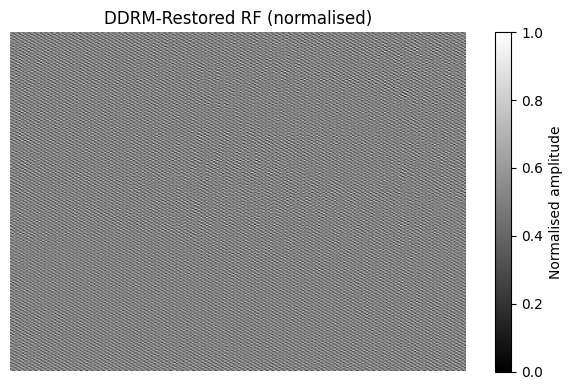

In [16]:
import scipy.io
import matplotlib.pyplot as plt
import numpy as np
import os

# ------------------------------------------------------------------
# Path to the vivo DDRM result
# ------------------------------------------------------------------
restored_path = (
    
    "mat_Restore_DDRM_vivo/restored_ddrm.mat"
)

# ------------------------------------------------------------------
# Helper: load variable from .mat and squeeze to 2-D
# ------------------------------------------------------------------
def load_var(mat_file, key="rf_restored"):
    mat = scipy.io.loadmat(mat_file)
    if key not in mat:
        raise KeyError(f"'{key}' not in {mat_file}")
    return mat[key].squeeze()          # (H, W)

# ------------------------------------------------------------------
# Load restored RF
# ------------------------------------------------------------------
rf_rest = load_var(restored_path, "rf_restored")

# ------------------------------------------------------------------
# Normalise to [0,1] for display
# ------------------------------------------------------------------
rf_vis = (rf_rest - rf_rest.min()).astype(np.float32)
rf_vis /= rf_vis.max() + 1e-8

# ------------------------------------------------------------------
# Plot
# ------------------------------------------------------------------
plt.figure(figsize=(6, 4))
plt.imshow(rf_vis, cmap="gray", aspect="auto")
plt.title("DDRM-Restored RF (normalised)")
plt.axis("off")
plt.colorbar(label="Normalised amplitude")
plt.tight_layout()
plt.show()


Loaded RF shape: (256, 256)


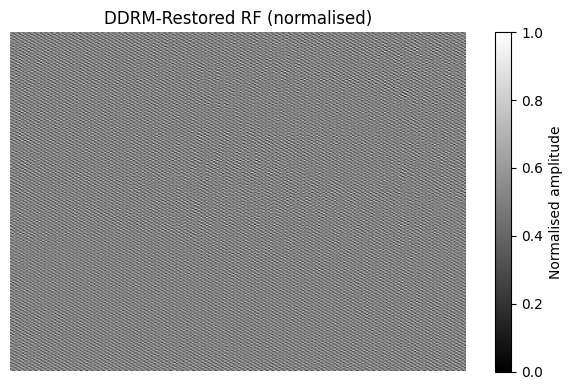

In [18]:
import numpy as np
import scipy.io
import matplotlib.pyplot as plt
import os

# ---------------------------------------------------------------
# 1) Pick the path that matches your environment
# ---------------------------------------------------------------
# If you’re running inside the MIRDDRM repo:
restored_path = (
    
    "mat_Restore_DDRM_vivo/restored_ddrm.mat"
)

# If you’re using the file you just uploaded:
# restored_path = "/mnt/data/restored_ddrm.mat"

# ---------------------------------------------------------------
# 2) Load the RF array (variable name: 'rf_restored')
# ---------------------------------------------------------------
mat = scipy.io.loadmat(restored_path)
if "rf_restored" not in mat:
    raise KeyError("'rf_restored' not found in the .mat file")
rf = mat["rf_restored"].squeeze()          # shape (256, 256)

print(f"Loaded RF shape: {rf.shape}")

# ---------------------------------------------------------------
# 3) Normalise to [0, 1] for consistent contrast
# ---------------------------------------------------------------
rf_vis = rf.astype(np.float32)
rf_vis -= rf_vis.min()
rf_vis /= (rf_vis.max() + 1e-8)

# ---------------------------------------------------------------
# 4) Plot
# ---------------------------------------------------------------
plt.figure(figsize=(6, 4))
plt.imshow(rf_vis, cmap="gray", aspect="auto")
plt.title("DDRM-Restored RF (normalised)")
plt.axis("off")
plt.colorbar(label="Normalised amplitude")
plt.tight_layout()
plt.show()


# Noise 

In [19]:
!python apply_degradation.py \
  --mat_dir  exp/datasets/anes_data/simu/1 \
  --mat_list exp/datasets/anes_data/simu/1/mat_list.txt \
  --key      GT_rf \
  --psf_path exp/datasets/anes_data/simu/1/psf_GT_1.mat \
  --image_size 256 \
  --sigma_0 0.01 \
  --output_dir mat_Degradation


Using device: cuda
✅ Found PSF key: psf_ref
✅ Saved:
   • ground_truth.mat   (GT_rf_resized)
   • degraded_y0.mat    (rf_degraded)


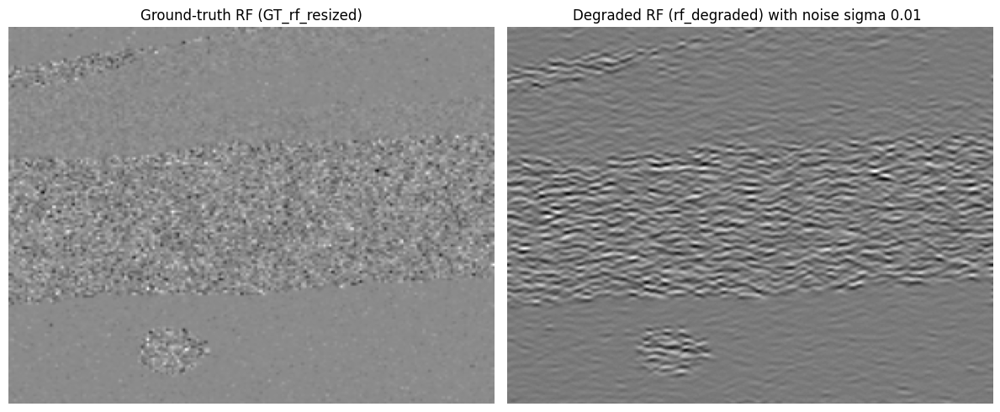

In [20]:
import scipy.io
import matplotlib.pyplot as plt
import numpy as np
import os

# ------------------------------------------------------------------
# 1.  Paths to the new .mat files
# ------------------------------------------------------------------
root_dir = "mat_Degradation"          # folder you chose when running apply_degradation.py
gt_path  = os.path.join(root_dir, "ground_truth.mat")
deg_path = os.path.join(root_dir, "degraded_y0.mat")

# ------------------------------------------------------------------
# 2.  Helper: load one variable from .mat
# ------------------------------------------------------------------
def load_var(mat_file, key):
    mat = scipy.io.loadmat(mat_file)
    if key not in mat:
        raise KeyError(f"'{key}' not found in {mat_file}")
    arr = mat[key]
    # if it ended up being 3-D (H, W, 1), squeeze to 2-D for display
    return arr.squeeze()

# ------------------------------------------------------------------
# 3.  Load arrays
# ------------------------------------------------------------------
gt_rf   = load_var(gt_path,  "GT_rf_resized")
deg_rf  = load_var(deg_path, "rf_degraded")

# ------------------------------------------------------------------
# 4.  Normalise to [0,1] for fair visual contrast
# ------------------------------------------------------------------
def normalise(img):
    img = img.astype(np.float32)
    img -= img.min()
    img /= (img.max() - img.min() + 1e-8)
    return img

gt_vis  = normalise(gt_rf)
deg_vis = normalise(deg_rf)

# ------------------------------------------------------------------
# 5.  Plot
# ------------------------------------------------------------------
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.imshow(gt_vis, cmap="gray", aspect="auto")
plt.title("Ground-truth RF (GT_rf_resized)")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(deg_vis, cmap="gray", aspect="auto")
plt.title("Degraded RF (rf_degraded) with noise sigma 0.01 ")
plt.axis("off")

plt.tight_layout()
plt.show()


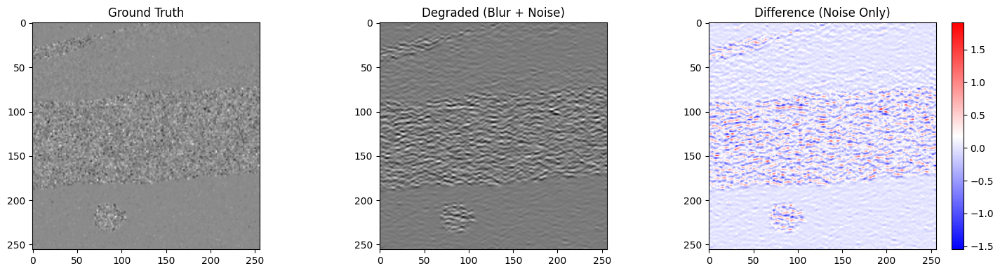

In [21]:
import scipy.io
import matplotlib.pyplot as plt
import numpy as np

# Load both .mat files
gt = scipy.io.loadmat("mat_Degradation/ground_truth.mat")["GT_rf_resized"]
degraded = scipy.io.loadmat("mat_Degradation/degraded_y0.mat")["rf_degraded"]

# Compute difference (residual noise)
diff = degraded - gt

# Show all
plt.figure(figsize=(15, 4))

plt.subplot(1, 3, 1)
plt.imshow(gt, cmap='gray')
plt.title("Ground Truth")

plt.subplot(1, 3, 2)
plt.imshow(degraded, cmap='gray')
plt.title("Degraded (Blur + Noise)")

plt.subplot(1, 3, 3)
plt.imshow(diff, cmap='bwr')
plt.title("Difference (Noise Only)")
plt.colorbar()

plt.tight_layout()
plt.show()


In [22]:
from skimage.metrics import peak_signal_noise_ratio as psnr, structural_similarity as ssim

print(f"PSNR: {psnr(gt_vis, deg_vis, data_range=1.0):.2f} dB")
print(f"SSIM: {ssim(gt_vis, deg_vis, data_range=1.0):.4f}")


PSNR: 17.56 dB
SSIM: 0.0220


In [1]:
!python run_ddrm_restoration.py \
  --degraded_mat  mat_Degradation/degraded_y0.mat \
  --gt_mat        mat_Degradation/ground_truth.mat \
  --psf_path      exp/datasets/anes_data/simu/1/psf_GT_1.mat \
  --model_path    exp/logs/imagenet/256x256_diffusion_uncond.pt \
  --config        deblur_us.yml \
  --timesteps     50 --eta 0.85 --etaB 1.0 \
  --output_dir    mat_Restore_DDRM


Module path: /projects/minds/PDAS-M2-2025/DDPM
Current sys.path: ['/projects/minds/PDAS-M2-2025/MIRDDRM', '/usr/lib/python310.zip', '/usr/lib/python3.10', '/usr/lib/python3.10/lib-dynload', '/home/pdas/.local/lib/python3.10/site-packages', '/usr/local/lib/python3.10/dist-packages', '/usr/local/lib/python3.10/dist-packages/nvfuser-0.1.4a0+d0bb811-py3.10-linux-x86_64.egg', '/usr/lib/python3/dist-packages', '/projects/minds/PDAS-M2-2025/DDPM']
File not found: /projects/minds/PDAS-M2-2025/DDPM/denoising_diffusion_pytorch.py
Import failed: No module named 'denoising_diffusion_pytorch'
Using device: cuda
✅ PSF loaded (key='psf_ref', shape=(11, 9))
INFO - main.py - 2025-05-16 15:56:00,908 - Using device: cuda
✅ Model checkpoint loaded
20it [00:13,  1.45it/s]
✅ Saved mat_Restore_DDRM/restored_ddrm.mat
PSNR: 10.29 dB   SSIM: 0.0460


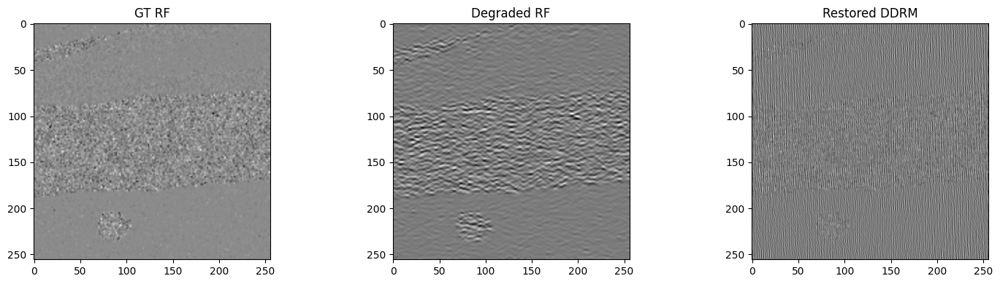

In [2]:
import scipy.io
import matplotlib.pyplot as plt

rf_rest = scipy.io.loadmat("mat_Restore_DDRM/restored_ddrm.mat")["rf_restored"]
gt_rf   = scipy.io.loadmat("mat_Degradation/ground_truth.mat")["GT_rf_resized"]
degr_rf = scipy.io.loadmat("mat_Degradation/degraded_y0.mat")["rf_degraded"]

plt.figure(figsize=(15, 4))
plt.subplot(1, 3, 1)
plt.imshow(gt_rf, cmap='gray'); plt.title("GT RF")

plt.subplot(1, 3, 2)
plt.imshow(degr_rf, cmap='gray'); plt.title("Degraded RF")

plt.subplot(1, 3, 3)
plt.imshow(rf_rest, cmap='gray'); plt.title("Restored DDRM")
plt.tight_layout()
plt.show()


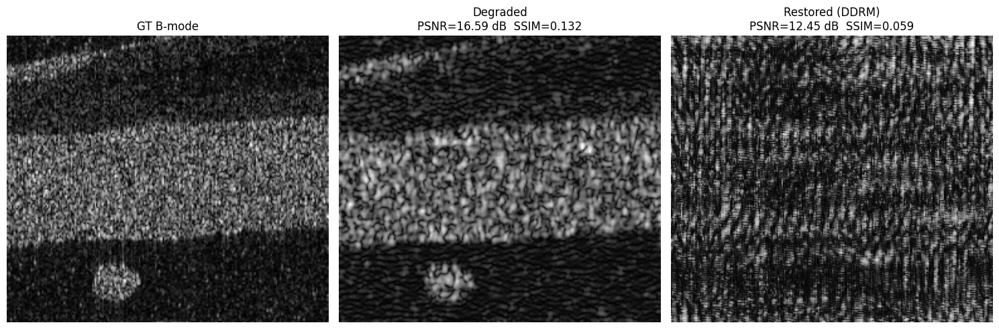

✅ B-mode images & comparison figure saved to mat_Restore_DDRM/


In [3]:
import numpy as np
import scipy.io
import matplotlib.pyplot as plt
from scipy.signal import hilbert
from skimage.exposure import match_histograms
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim
from pathlib import Path

# ---------------------------------------------------------------------
# 1. Reusable RF → B-mode converter that can skip / apply hist-matching
# ---------------------------------------------------------------------
def rf_to_bmode(
    rf: np.ndarray,
    ref_bmode: np.ndarray | None = None,
    dr_db: float = 60.0,
    eps: float = 1e-6,
) -> np.ndarray:
    """
    Convert RF → B-mode (uint8, 0-255). If ref_bmode is supplied,
    histogram-match the output to its intensity profile.
    """
    env = np.abs(hilbert(rf, axis=0))
    log = 20.0 * np.log10(env + eps)
    log = np.clip(log, -dr_db, None)

    # normalise to 0-255
    log -= log.min()
    log *= 255.0 / (log.max() + eps)

    if ref_bmode is not None:
        ref = ref_bmode[..., 0] if ref_bmode.ndim == 3 else ref_bmode
        log = match_histograms(log, ref, channel_axis=None)

    return np.clip(log, 0, 255).astype(np.uint8)


# ---------------------------------------------------------------------
# 2. Load the three RF images (GT, degraded, restored)
# ---------------------------------------------------------------------
paths = {
    "gt":        Path("mat_Degradation/ground_truth.mat"),
    "degraded":  Path("mat_Degradation/degraded_y0.mat"),
    "restored":  Path("mat_Restore_DDRM/restored_ddrm.mat"),
}

rf_gt        = scipy.io.loadmat(paths["gt"])       .get("GT_rf_resized")
rf_degraded  = scipy.io.loadmat(paths["degraded"]) .get("rf_degraded")
rf_restored  = scipy.io.loadmat(paths["restored"]) .get("rf_restored")

# ---------------------------------------------------------------------
# 3. Load Simu-1 ground-truth B-mode to use as reference
# ---------------------------------------------------------------------
bmode_GT = scipy.io.loadmat("exp/datasets/anes_data/simu/1/data.mat")["bmode_GT"]

# ---------------------------------------------------------------------
# 4. Optionally histogram-match RFs to GT-RF before envelope detection
#    (keeps fair scaling between degraded / restored)
# ---------------------------------------------------------------------
rf_degraded = match_histograms(rf_degraded, rf_gt, channel_axis=None)
rf_restored = match_histograms(rf_restored, rf_gt, channel_axis=None)

# ---------------------------------------------------------------------
# 5. Convert all three to B-mode with matching to Simu-1 GT B-mode
# ---------------------------------------------------------------------
b_gt   = rf_to_bmode(rf_gt,        ref_bmode=bmode_GT)
b_deg  = rf_to_bmode(rf_degraded,  ref_bmode=bmode_GT)
b_rest = rf_to_bmode(rf_restored,  ref_bmode=bmode_GT)

# ---------------------------------------------------------------------
# 6. Metrics (on uint8 B-mode for visual relevance)
# ---------------------------------------------------------------------
psnr_deg = psnr(b_gt, b_deg, data_range=255)
ssim_deg = ssim(b_gt, b_deg, data_range=255)

psnr_res = psnr(b_gt, b_rest, data_range=255)
ssim_res = ssim(b_gt, b_rest, data_range=255)

# ---------------------------------------------------------------------
# 7. Plot & save figure
# ---------------------------------------------------------------------
fig, ax = plt.subplots(1, 3, figsize=(15, 5))

titles = [
    "GT B-mode",
    f"Degraded\nPSNR={psnr_deg:.2f} dB  SSIM={ssim_deg:.3f}",
    f"Restored (DDRM)\nPSNR={psnr_res:.2f} dB  SSIM={ssim_res:.3f}",
]
for a, img, t in zip(ax, [b_gt, b_deg, b_rest], titles):
    a.imshow(img, cmap="gray", aspect="auto")
    a.set_title(t)
    a.axis("off")

plt.tight_layout()
fig.savefig("mat_Restore_DDRM/bmode_comparison.png", dpi=300, bbox_inches="tight")
plt.show()

# ---------------------------------------------------------------------
# 8. Save individual B-mode images for downstream use
# ---------------------------------------------------------------------
scipy.io.savemat("mat_Restore_DDRM/bmode_gt.mat",       {"bmode_gt": b_gt})
scipy.io.savemat("mat_Restore_DDRM/bmode_degraded.mat", {"bmode_degraded": b_deg})
scipy.io.savemat("mat_Restore_DDRM/bmode_restored.mat", {"bmode_restored": b_rest})

print("✅ B-mode images & comparison figure saved to mat_Restore_DDRM/")


In [23]:
!python run_ddrm_restoration.py \
  --degraded_mat  mat_Degradation/degraded_y0.mat \
  --gt_mat        mat_Degradation/ground_truth.mat \
  --psf_path      exp/datasets/anes_data/simu/1/psf_GT_1.mat \
  --model_path    exp/logs/imagenet/256x256_diffusion_uncond.pt \
  --config        deblur_us.yml \
  --timesteps     100 \
  --eta           0.9 \
  --etaB          1.0 \
  --sigma_0       0.01 \
  --output_dir    mat_Restore_DDRM


Module path: /projects/minds/PDAS-M2-2025/DDPM
Current sys.path: ['/projects/minds/PDAS-M2-2025/MIRDDRM', '/usr/lib/python310.zip', '/usr/lib/python3.10', '/usr/lib/python3.10/lib-dynload', '/home/pdas/.local/lib/python3.10/site-packages', '/usr/local/lib/python3.10/dist-packages', '/usr/local/lib/python3.10/dist-packages/nvfuser-0.1.4a0+d0bb811-py3.10-linux-x86_64.egg', '/usr/lib/python3/dist-packages', '/projects/minds/PDAS-M2-2025/DDPM']
File not found: /projects/minds/PDAS-M2-2025/DDPM/denoising_diffusion_pytorch.py
Import failed: No module named 'denoising_diffusion_pytorch'
Using device: cuda
✅ PSF loaded (key='psf_ref', shape=(11, 9))
INFO - main.py - 2025-05-19 11:33:43,980 - Using device: cuda
✅ Model checkpoint loaded
100it [00:44,  2.26it/s]
✅ Saved mat_Restore_DDRM/restored_ddrm.mat
PSNR: 29.17 dB   SSIM: 0.7676


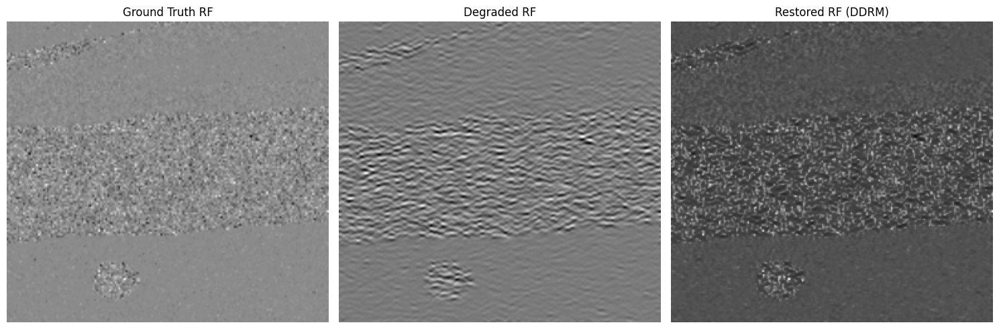

In [24]:
import scipy.io
import matplotlib.pyplot as plt
import numpy as np

def normalize(img):
    img = img.astype(np.float32)
    img -= img.min()
    img /= (img.max() - img.min() + 1e-8)
    return img

gt = scipy.io.loadmat("mat_Degradation/ground_truth.mat")["GT_rf_resized"].squeeze()
deg = scipy.io.loadmat("mat_Degradation/degraded_y0.mat")["rf_degraded"].squeeze()
rest = scipy.io.loadmat("mat_Restore_DDRM/restored_ddrm.mat")["rf_restored"].squeeze()

plt.figure(figsize=(15, 5))
titles = ["Ground Truth RF", "Degraded RF", "Restored RF (DDRM)"]
for i, (img, title) in enumerate(zip([gt, deg, rest], titles)):
    plt.subplot(1, 3, i + 1)
    plt.imshow(normalize(img), cmap="gray", aspect="auto")
    plt.title(title)
    plt.axis("off")
plt.tight_layout()
plt.show()


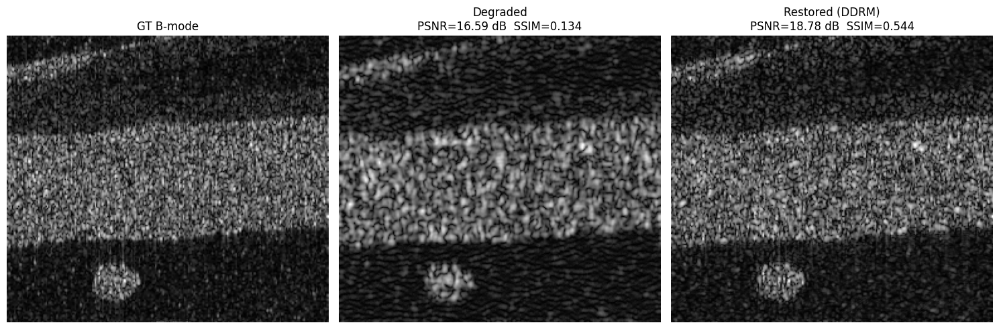

✅ B-mode images & comparison figure saved to mat_Restore_DDRM/


In [25]:
import numpy as np
import scipy.io
import matplotlib.pyplot as plt
from scipy.signal import hilbert
from skimage.exposure import match_histograms
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim
from pathlib import Path

# ---------------------------------------------------------------------
# 1. Reusable RF → B-mode converter that can skip / apply hist-matching
# ---------------------------------------------------------------------
def rf_to_bmode(
    rf: np.ndarray,
    ref_bmode: np.ndarray | None = None,
    dr_db: float = 60.0,
    eps: float = 1e-6,
) -> np.ndarray:
    """
    Convert RF → B-mode (uint8, 0-255). If ref_bmode is supplied,
    histogram-match the output to its intensity profile.
    """
    env = np.abs(hilbert(rf, axis=0))
    log = 20.0 * np.log10(env + eps)
    log = np.clip(log, -dr_db, None)

    # normalise to 0-255
    log -= log.min()
    log *= 255.0 / (log.max() + eps)

    if ref_bmode is not None:
        ref = ref_bmode[..., 0] if ref_bmode.ndim == 3 else ref_bmode
        log = match_histograms(log, ref, channel_axis=None)

    return np.clip(log, 0, 255).astype(np.uint8)


# ---------------------------------------------------------------------
# 2. Load the three RF images (GT, degraded, restored)
# ---------------------------------------------------------------------
paths = {
    "gt":        Path("mat_Degradation/ground_truth.mat"),
    "degraded":  Path("mat_Degradation/degraded_y0.mat"),
    "restored":  Path("mat_Restore_DDRM/restored_ddrm.mat"),
}

rf_gt        = scipy.io.loadmat(paths["gt"])       .get("GT_rf_resized")
rf_degraded  = scipy.io.loadmat(paths["degraded"]) .get("rf_degraded")
rf_restored  = scipy.io.loadmat(paths["restored"]) .get("rf_restored")

# ---------------------------------------------------------------------
# 3. Load Simu-1 ground-truth B-mode to use as reference
# ---------------------------------------------------------------------
bmode_GT = scipy.io.loadmat("exp/datasets/anes_data/simu/1/data.mat")["bmode_GT"]

# ---------------------------------------------------------------------
# 4. Optionally histogram-match RFs to GT-RF before envelope detection
#    (keeps fair scaling between degraded / restored)
# ---------------------------------------------------------------------
rf_degraded = match_histograms(rf_degraded, rf_gt, channel_axis=None)
rf_restored = match_histograms(rf_restored, rf_gt, channel_axis=None)

# ---------------------------------------------------------------------
# 5. Convert all three to B-mode with matching to Simu-1 GT B-mode
# ---------------------------------------------------------------------
b_gt   = rf_to_bmode(rf_gt,        ref_bmode=bmode_GT)
b_deg  = rf_to_bmode(rf_degraded,  ref_bmode=bmode_GT)
b_rest = rf_to_bmode(rf_restored,  ref_bmode=bmode_GT)

# ---------------------------------------------------------------------
# 6. Metrics (on uint8 B-mode for visual relevance)
# ---------------------------------------------------------------------
psnr_deg = psnr(b_gt, b_deg, data_range=255)
ssim_deg = ssim(b_gt, b_deg, data_range=255)

psnr_res = psnr(b_gt, b_rest, data_range=255)
ssim_res = ssim(b_gt, b_rest, data_range=255)

# ---------------------------------------------------------------------
# 7. Plot & save figure
# ---------------------------------------------------------------------
fig, ax = plt.subplots(1, 3, figsize=(15, 5))

titles = [
    "GT B-mode",
    f"Degraded\nPSNR={psnr_deg:.2f} dB  SSIM={ssim_deg:.3f}",
    f"Restored (DDRM)\nPSNR={psnr_res:.2f} dB  SSIM={ssim_res:.3f}",
]
for a, img, t in zip(ax, [b_gt, b_deg, b_rest], titles):
    a.imshow(img, cmap="gray", aspect="auto")
    a.set_title(t)
    a.axis("off")

plt.tight_layout()
fig.savefig("mat_Restore_DDRM/bmode_comparison.png", dpi=300, bbox_inches="tight")
plt.show()

# ---------------------------------------------------------------------
# 8. Save individual B-mode images for downstream use
# ---------------------------------------------------------------------
scipy.io.savemat("mat_Restore_DDRM/bmode_gt.mat",       {"bmode_gt": b_gt})
scipy.io.savemat("mat_Restore_DDRM/bmode_degraded.mat", {"bmode_degraded": b_deg})
scipy.io.savemat("mat_Restore_DDRM/bmode_restored.mat", {"bmode_restored": b_rest})

print("✅ B-mode images & comparison figure saved to mat_Restore_DDRM/")


### Apply a 3x3 median filter

In [13]:
from scipy.ndimage import median_filter
import scipy.io

# Load the restored RF image from DDRM output
rest = scipy.io.loadmat("mat_Restore_DDRM/restored_ddrm.mat")["rf_restored"]

# Apply a 3x3 median filter (you can try size=5 for more smoothing)
rest_denoised = median_filter(rest, size=3)

# Save the denoised version as a new .mat file
scipy.io.savemat("mat_Restore_DDRM/restored_ddrm_denoised.mat", {"rf_restored": rest_denoised})


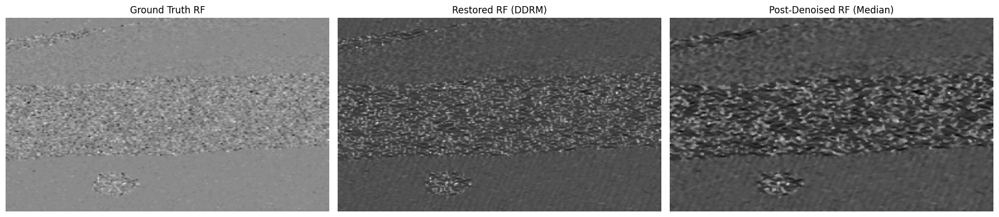

In [14]:
import matplotlib.pyplot as plt
import numpy as np

gt = scipy.io.loadmat("mat_Degradation/ground_truth.mat")["GT_rf_resized"]
rest = scipy.io.loadmat("mat_Restore_DDRM/restored_ddrm.mat")["rf_restored"]
rest_denoised = scipy.io.loadmat("mat_Restore_DDRM/restored_ddrm_denoised.mat")["rf_restored"]

def normalize(x):
    x = x.astype(np.float32)
    x -= x.min()
    x /= (x.max() - x.min() + 1e-8)
    return x

plt.figure(figsize=(18,4))
titles = ["Ground Truth RF", "Restored RF (DDRM)", "Post-Denoised RF (Median)"]
for i, (img, title) in enumerate(zip([gt, rest, rest_denoised], titles)):
    plt.subplot(1,3,i+1)
    plt.imshow(normalize(img), cmap="gray", aspect="auto")
    plt.title(title)
    plt.axis("off")
plt.tight_layout()
plt.show()


In [15]:
from skimage.metrics import peak_signal_noise_ratio as psnr, structural_similarity as ssim

gt_n = normalize(gt)
rest_n = normalize(rest)
denoised_n = normalize(rest_denoised)
print("PSNR (Restored):", psnr(gt_n, rest_n, data_range=1))
print("PSNR (Denoised):", psnr(gt_n, denoised_n, data_range=1))
print("SSIM (Restored):", ssim(gt_n, rest_n, data_range=1))
print("SSIM (Denoised):", ssim(gt_n, denoised_n, data_range=1))


PSNR (Restored): 12.69947548808037
PSNR (Denoised): 12.172693187647441
SSIM (Restored): 0.6635942491115332
SSIM (Denoised): 0.5941596574957371


In [16]:
!python run_ddrm_restoration.py \
  --degraded_mat  mat_Degradation/degraded_y0.mat \
  --gt_mat        mat_Degradation/ground_truth.mat \
  --psf_path      exp/datasets/anes_data/simu/1/psf_GT_1.mat \
  --model_path    exp/logs/imagenet/256x256_diffusion_uncond.pt \
  --config        deblur_us.yml \
  --timesteps     150 \
  --eta           0.9 \
  --etaB          1.0 \
  --sigma_0       0.01 \
  --output_dir    mat_Restore_DDRM


Module path: /projects/minds/PDAS-M2-2025/DDPM
Current sys.path: ['/projects/minds/PDAS-M2-2025/MIRDDRM', '/usr/lib/python310.zip', '/usr/lib/python3.10', '/usr/lib/python3.10/lib-dynload', '/home/pdas/.local/lib/python3.10/site-packages', '/usr/local/lib/python3.10/dist-packages', '/usr/local/lib/python3.10/dist-packages/nvfuser-0.1.4a0+d0bb811-py3.10-linux-x86_64.egg', '/usr/lib/python3/dist-packages', '/projects/minds/PDAS-M2-2025/DDPM']
File not found: /projects/minds/PDAS-M2-2025/DDPM/denoising_diffusion_pytorch.py
Import failed: No module named 'denoising_diffusion_pytorch'
Using device: cuda
✅ PSF loaded (key='psf_ref', shape=(11, 9))
INFO - main.py - 2025-05-19 11:30:32,662 - Using device: cuda
✅ Model checkpoint loaded
167it [01:09,  2.39it/s]
✅ Saved mat_Restore_DDRM/restored_ddrm.mat
PSNR: 27.68 dB   SSIM: 0.6869


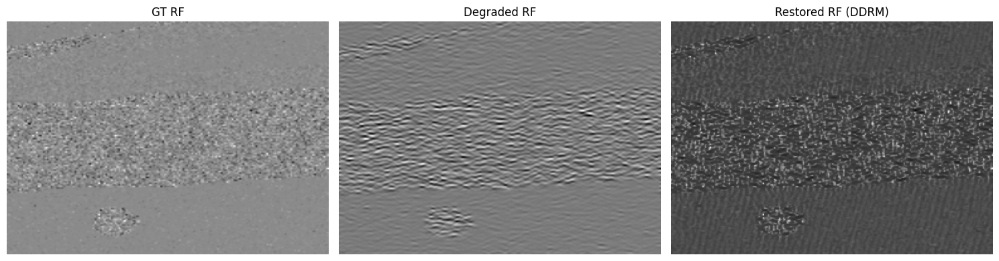

In [17]:
import scipy.io
import matplotlib.pyplot as plt
import numpy as np

gt = scipy.io.loadmat("mat_Degradation/ground_truth.mat")["GT_rf_resized"]
deg = scipy.io.loadmat("mat_Degradation/degraded_y0.mat")["rf_degraded"]
rest = scipy.io.loadmat("mat_Restore_DDRM/restored_ddrm.mat")["rf_restored"]

def normalize(x):
    x = x.astype(np.float32)
    x -= x.min()
    x /= (x.max() - x.min() + 1e-8)
    return x

plt.figure(figsize=(15,4))
for i, (img, title) in enumerate(zip(
    [normalize(gt), normalize(deg), normalize(rest)],
    ["GT RF", "Degraded RF", "Restored RF (DDRM)"])):
    plt.subplot(1,3,i+1)
    plt.imshow(img, cmap="gray", aspect="auto")
    plt.title(title)
    plt.axis("off")
plt.tight_layout()
plt.show()


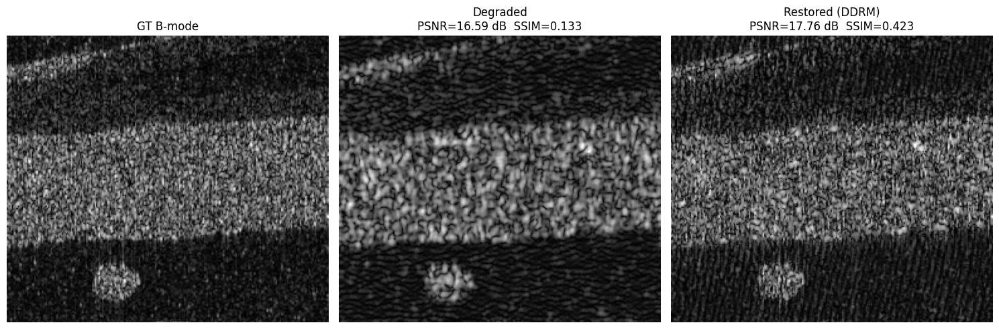

✅ B-mode images & comparison figure saved to mat_Restore_DDRM/


In [18]:
import numpy as np
import scipy.io
import matplotlib.pyplot as plt
from scipy.signal import hilbert
from skimage.exposure import match_histograms
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim
from pathlib import Path

# ---------------------------------------------------------------------
# 1. Reusable RF → B-mode converter that can skip / apply hist-matching
# ---------------------------------------------------------------------
def rf_to_bmode(
    rf: np.ndarray,
    ref_bmode: np.ndarray | None = None,
    dr_db: float = 60.0,
    eps: float = 1e-6,
) -> np.ndarray:
    """
    Convert RF → B-mode (uint8, 0-255). If ref_bmode is supplied,
    histogram-match the output to its intensity profile.
    """
    env = np.abs(hilbert(rf, axis=0))
    log = 20.0 * np.log10(env + eps)
    log = np.clip(log, -dr_db, None)

    # normalise to 0-255
    log -= log.min()
    log *= 255.0 / (log.max() + eps)

    if ref_bmode is not None:
        ref = ref_bmode[..., 0] if ref_bmode.ndim == 3 else ref_bmode
        log = match_histograms(log, ref, channel_axis=None)

    return np.clip(log, 0, 255).astype(np.uint8)


# ---------------------------------------------------------------------
# 2. Load the three RF images (GT, degraded, restored)
# ---------------------------------------------------------------------
paths = {
    "gt":        Path("mat_Degradation/ground_truth.mat"),
    "degraded":  Path("mat_Degradation/degraded_y0.mat"),
    "restored":  Path("mat_Restore_DDRM/restored_ddrm.mat"),
}

rf_gt        = scipy.io.loadmat(paths["gt"])       .get("GT_rf_resized")
rf_degraded  = scipy.io.loadmat(paths["degraded"]) .get("rf_degraded")
rf_restored  = scipy.io.loadmat(paths["restored"]) .get("rf_restored")

# ---------------------------------------------------------------------
# 3. Load Simu-1 ground-truth B-mode to use as reference
# ---------------------------------------------------------------------
bmode_GT = scipy.io.loadmat("exp/datasets/anes_data/simu/1/data.mat")["bmode_GT"]

# ---------------------------------------------------------------------
# 4. Optionally histogram-match RFs to GT-RF before envelope detection
#    (keeps fair scaling between degraded / restored)
# ---------------------------------------------------------------------
rf_degraded = match_histograms(rf_degraded, rf_gt, channel_axis=None)
rf_restored = match_histograms(rf_restored, rf_gt, channel_axis=None)

# ---------------------------------------------------------------------
# 5. Convert all three to B-mode with matching to Simu-1 GT B-mode
# ---------------------------------------------------------------------
b_gt   = rf_to_bmode(rf_gt,        ref_bmode=bmode_GT)
b_deg  = rf_to_bmode(rf_degraded,  ref_bmode=bmode_GT)
b_rest = rf_to_bmode(rf_restored,  ref_bmode=bmode_GT)

# ---------------------------------------------------------------------
# 6. Metrics (on uint8 B-mode for visual relevance)
# ---------------------------------------------------------------------
psnr_deg = psnr(b_gt, b_deg, data_range=255)
ssim_deg = ssim(b_gt, b_deg, data_range=255)

psnr_res = psnr(b_gt, b_rest, data_range=255)
ssim_res = ssim(b_gt, b_rest, data_range=255)

# ---------------------------------------------------------------------
# 7. Plot & save figure
# ---------------------------------------------------------------------
fig, ax = plt.subplots(1, 3, figsize=(15, 5))

titles = [
    "GT B-mode",
    f"Degraded\nPSNR={psnr_deg:.2f} dB  SSIM={ssim_deg:.3f}",
    f"Restored (DDRM)\nPSNR={psnr_res:.2f} dB  SSIM={ssim_res:.3f}",
]
for a, img, t in zip(ax, [b_gt, b_deg, b_rest], titles):
    a.imshow(img, cmap="gray", aspect="auto")
    a.set_title(t)
    a.axis("off")

plt.tight_layout()
fig.savefig("mat_Restore_DDRM/bmode_comparison.png", dpi=300, bbox_inches="tight")
plt.show()

# ---------------------------------------------------------------------
# 8. Save individual B-mode images for downstream use
# ---------------------------------------------------------------------
scipy.io.savemat("mat_Restore_DDRM/bmode_gt.mat",       {"bmode_gt": b_gt})
scipy.io.savemat("mat_Restore_DDRM/bmode_degraded.mat", {"bmode_degraded": b_deg})
scipy.io.savemat("mat_Restore_DDRM/bmode_restored.mat", {"bmode_restored": b_rest})

print("✅ B-mode images & comparison figure saved to mat_Restore_DDRM/")


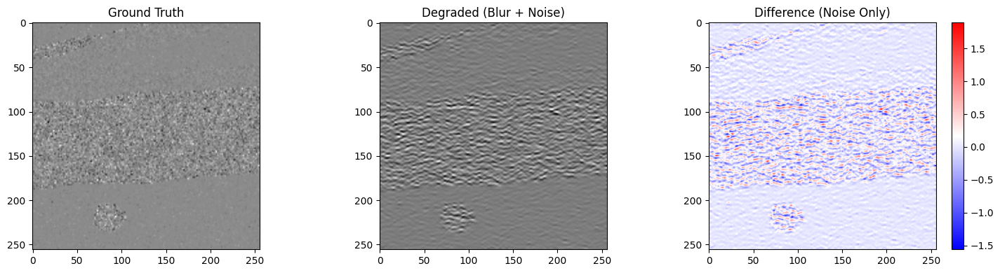

In [8]:
import scipy.io
import matplotlib.pyplot as plt
import numpy as np

# Load both .mat files
gt = scipy.io.loadmat("mat_Degradation/ground_truth.mat")["GT_rf_resized"]
degraded = scipy.io.loadmat("mat_Degradation/degraded_y0.mat")["rf_degraded"]

# Compute difference (residual noise)
diff = degraded - gt

# Show all
plt.figure(figsize=(15, 4))

plt.subplot(1, 3, 1)
plt.imshow(gt, cmap='gray')
plt.title("Ground Truth")

plt.subplot(1, 3, 2)
plt.imshow(degraded, cmap='gray')
plt.title("Degraded (Blur + Noise)")

plt.subplot(1, 3, 3)
plt.imshow(diff, cmap='bwr')
plt.title("Difference (Noise Only)")
plt.colorbar()

plt.tight_layout()
plt.show()


In [9]:
import scipy.io


# Check shape and size
if gt is not None:
    print("✅ GT_rf found")
    print("Shape:", gt.shape)
    print("Size: ", gt.size)
else:
    print("❌ GT not found")

print()

if degraded is not None:
    print("✅ PSF_estim found")
    print("Shape:", degraded.shape)
    print("Size: ", degraded.size)
else:
    print("❌ degraded not found")


✅ GT_rf found
Shape: (256, 256)
Size:  65536

✅ PSF_estim found
Shape: (256, 256)
Size:  65536


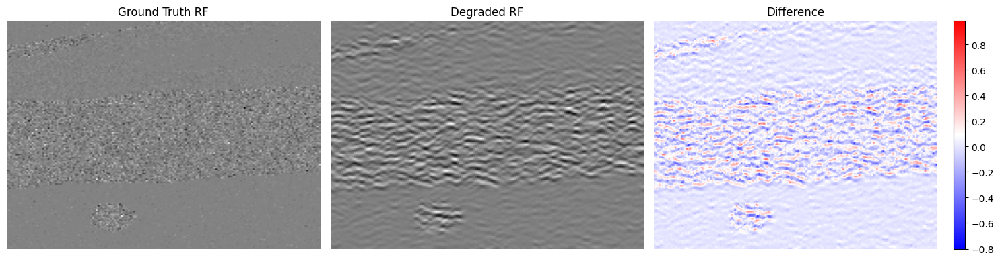

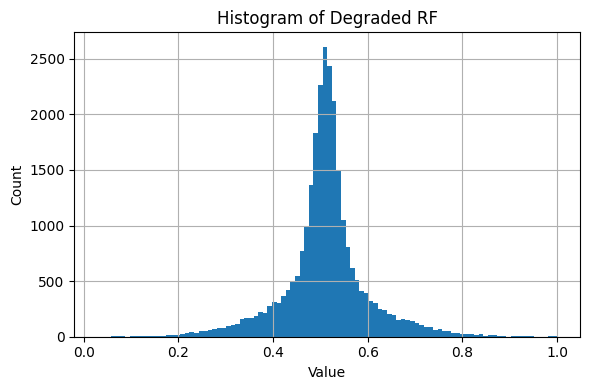

In [1]:
import numpy as np
import scipy.io
import matplotlib.pyplot as plt
import torch
import os

# =============================================
# ✅ Simple FFT-based BCCB Convolution Class
# =============================================
class BCCBConv:
    def __init__(self, psf, shape, device):
        """
        psf: 2D numpy array (Mh×Nh)
        shape: (H, W) target RF image shape
        """
        self.device = device
        H, W = shape
        Mh, Nh = psf.shape

        # 1) Zero-pad the PSF to (H, W)
        padded = np.zeros((H, W), dtype=np.float32)
        padded[:Mh, :Nh] = psf

        # 2) Center the PSF (roll so that its center is at (0,0))
        center = (Mh//2, Nh//2)
        shifted = np.roll(np.roll(padded, -center[0], axis=0),
                          -center[1], axis=1)

        # 3) Precompute FFT of PSF
        psf_tensor = torch.tensor(shifted, dtype=torch.float32, device=device)
        self.H_fft = torch.fft.rfftn(psf_tensor, s=(H, W))

    def H(self, x):
        """
        x: torch tensor of shape (B, C, H, W), real-valued
        returns: torch tensor (B, C, H, W), real-valued
        """
        # Compute FFT along last two dims
        X_fft = torch.fft.rfftn(x, dim=(-2, -1))
        # Multiply in freq domain (broadcast over C)
        Y_fft = X_fft * self.H_fft[None, None, ...]
        # Inverse FFT back to spatial
        y = torch.fft.irfftn(Y_fft, s=x.shape[-2:], dim=(-2, -1))
        return y.real


# =============================================
# ✅ Full Jupyter Pipeline
# =============================================
# Paths
gt_path  = "exp/datasets/anes_data/simu/1/data.mat"
psf_path = "exp/datasets/anes_data/simu/1/psf_GT_1.mat"

# Load RF and PSF
mat = scipy.io.loadmat(gt_path)
gt    = mat["GT_rf"].astype(np.float32)          # (H, W)
psf_mat = scipy.io.loadmat(psf_path)
psf   = psf_mat.get("psf_ref", None)
if psf is None:
    psf = next(v for k, v in psf_mat.items() if not k.startswith("__")).astype(np.float32)

H, W = gt.shape
device = "cuda" if torch.cuda.is_available() else "cpu"

# Normalize RF to [0,1]
gt_norm = (gt - gt.min()) / (gt.max() - gt.min() + 1e-8)

# Create tensor (B=1, C=1→3 for PSF use, H, W)
x = torch.tensor(gt_norm, dtype=torch.float32, device=device)
x = x.unsqueeze(0).unsqueeze(0).repeat(1, 3, 1, 1) * 2 - 1  # in [-1,1]

# Apply BCCB convolution + noise
bccb = BCCBConv(psf, shape=(H, W), device=device)
y0 = bccb.H(x)
sigma_0 = 0.01
y0 = y0 + sigma_0 * torch.randn_like(y0)

# Convert back to single-channel spatial images
gt_img  = gt_norm
deg_img = ((y0[0,0].cpu().numpy() + 1)/2).clip(0,1)  # undo [-1,1] → [0,1]

# Save results
os.makedirs("mat_Degradation", exist_ok=True)
scipy.io.savemat("mat_Degradation/ground_truth.mat", {"GT_rf": gt})
scipy.io.savemat("mat_Degradation/degraded_y0.mat", {"rf_degraded": deg_img})

# =============================================
# ✅ Visualize
# =============================================
diff = deg_img - gt_img

plt.figure(figsize=(15,4))
plt.subplot(1,3,1)
plt.imshow(gt_img, cmap="gray", aspect="auto")
plt.title("Ground Truth RF")
plt.axis("off")

plt.subplot(1,3,2)
plt.imshow(deg_img, cmap="gray", aspect="auto")
plt.title("Degraded RF")
plt.axis("off")

plt.subplot(1,3,3)
plt.imshow(diff, cmap="bwr", aspect="auto")
plt.title("Difference")
plt.colorbar(fraction=0.046)
plt.axis("off")
plt.tight_layout()
plt.show()

# Histogram
plt.figure(figsize=(6,4))
plt.hist(deg_img.ravel(), bins=100)
plt.title("Histogram of Degraded RF")
plt.xlabel("Value")
plt.ylabel("Count")
plt.grid(True)
plt.tight_layout()
plt.show()


Wiener PSNR: 12.86 dB   SSIM: 0.0545


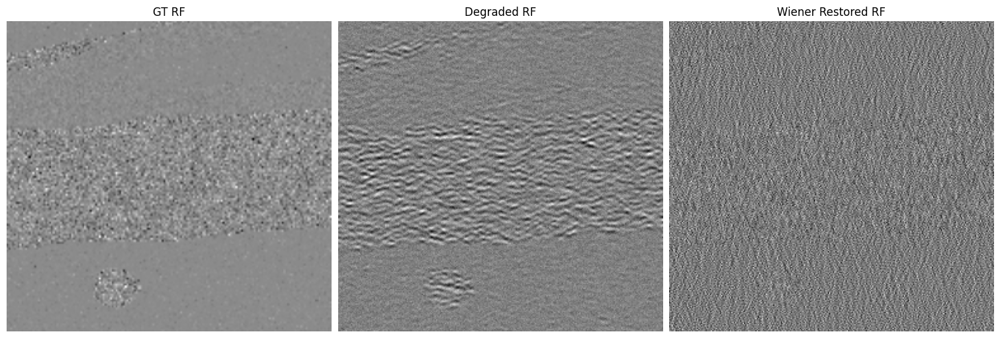

In [16]:
import numpy as np
import scipy.io
import matplotlib.pyplot as plt
from skimage.metrics import peak_signal_noise_ratio as psnr, structural_similarity as ssim
import os

# --------------------------------------
# 1. Paths
# --------------------------------------
root = "mat_Degradation"
gt_path  = os.path.join(root, "ground_truth.mat")
deg_path = os.path.join(root, "degraded_y0.mat")
psf_path = "exp/datasets/anes_data/simu/1/psf_GT_1.mat"

# --------------------------------------
# 2. Load GT and degraded RF
# --------------------------------------
gt_mat  = scipy.io.loadmat(gt_path)
deg_mat = scipy.io.loadmat(deg_path)
rf_gt       = gt_mat["GT_rf_resized"].squeeze()
rf_degraded = deg_mat["rf_degraded"].squeeze()

# --------------------------------------
# 3. Load PSF
# --------------------------------------
psf_mat = scipy.io.loadmat(psf_path)
if "psf_ref" in psf_mat:
    psf = psf_mat["psf_ref"]
elif "PSF_estim" in psf_mat:
    psf = psf_mat["PSF_estim"]
else:
    psf = next(v for k, v in psf_mat.items() if not k.startswith("__"))

# --------------------------------------
# 4. Wiener deconvolution
# --------------------------------------
def wiener_deconvolution(y, psf, K=0.01):
    H, W = y.shape
    Mh, Nh = psf.shape
    padded = np.zeros((H, W), dtype=np.float32)
    padded[:Mh, :Nh] = psf
    center = (Mh//2, Nh//2)
    shifted = np.roll(np.roll(padded, -center[0], axis=0), -center[1], axis=1)
    H_fft = np.fft.fft2(shifted)
    Y_fft = np.fft.fft2(y)
    H_conj = np.conj(H_fft)
    H_abs2 = np.abs(H_fft)**2
    X_hat = (H_conj / (H_abs2 + K)) * Y_fft
    return np.real(np.fft.ifft2(X_hat))

rf_wiener = wiener_deconvolution(rf_degraded, psf, K=0.01)

# --------------------------------------
# 5. Save Wiener result
# --------------------------------------
os.makedirs(root, exist_ok=True)
scipy.io.savemat(os.path.join(root, "wiener_pre_ddrm.mat"),
                 {"rf_degraded": rf_wiener})

# --------------------------------------
# 6. Compute PSNR & SSIM
# --------------------------------------
psnr_val = psnr(rf_gt, rf_wiener, data_range=rf_gt.max()-rf_gt.min())
ssim_val = ssim(rf_gt, rf_wiener, data_range=rf_gt.max()-rf_gt.min())
print(f"Wiener PSNR: {psnr_val:.2f} dB   SSIM: {ssim_val:.4f}")

# --------------------------------------
# 7. Visualize all three RFs
# --------------------------------------
def normalize(img):
    img = img.astype(np.float32)
    img -= img.min()
    img /= (img.max()-img.min()+1e-8)
    return img

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
for ax, img, title in zip(
    axes,
    [rf_gt, rf_degraded, rf_wiener],
    ["GT RF", "Degraded RF", "Wiener Restored RF"]
):
    ax.imshow(normalize(img), cmap="gray", aspect="auto")
    ax.set_title(title)
    ax.axis("off")

plt.savefig(os.path.join(root, "rf_wiener_comparison.png"), dpi=300)
plt.show()


In [20]:
!python run_ddrm_restoration.py \
  --degraded_mat  mat_Degradation/degraded_y0.mat \
  --gt_mat        mat_Degradation/ground_truth.mat \
  --psf_path      exp/datasets/anes_data/simu/1/psf_GT_1.mat \
  --model_path    exp/logs/imagenet/256x256_diffusion_uncond.pt \
  --config        deblur_us.yml \
  --timesteps     100 \
  --eta           0.9 \
  --etaB          1.0 \
  --sigma_0       0.01 \
  --output_dir    mat_Restore_DDRM_Wiener


Module path: /projects/minds/PDAS-M2-2025/DDPM
Current sys.path: ['/projects/minds/PDAS-M2-2025/MIRDDRM', '/usr/lib/python310.zip', '/usr/lib/python3.10', '/usr/lib/python3.10/lib-dynload', '/home/pdas/.local/lib/python3.10/site-packages', '/usr/local/lib/python3.10/dist-packages', '/usr/local/lib/python3.10/dist-packages/nvfuser-0.1.4a0+d0bb811-py3.10-linux-x86_64.egg', '/usr/lib/python3/dist-packages', '/projects/minds/PDAS-M2-2025/DDPM']
File not found: /projects/minds/PDAS-M2-2025/DDPM/denoising_diffusion_pytorch.py
Import failed: No module named 'denoising_diffusion_pytorch'
Using device: cuda
✅ PSF loaded (key='psf_ref', shape=(11, 9))
INFO - main.py - 2025-05-16 16:40:21,853 - Using device: cuda
✅ Model checkpoint loaded
100it [00:44,  2.26it/s]
✅ Saved mat_Restore_DDRM_Wiener/restored_ddrm.mat
PSNR: 10.13 dB   SSIM: 0.0074


In [21]:
!python run_ddrm_restoration.py \
  --degraded_mat  mat_Degradation/wiener_pre_ddrm.mat \
  --gt_mat        mat_Degradation/ground_truth.mat \
  --psf_path      exp/datasets/anes_data/simu/1/psf_GT_1.mat \
  --model_path    exp/logs/imagenet/256x256_diffusion_uncond.pt \
  --config        deblur_us.yml \
  --timesteps     100 \
  --eta           0.9 \
  --etaB          1.0 \
  --sigma_0       0.005 \
  --output_dir    mat_Restore_DDRM_Wiener


Module path: /projects/minds/PDAS-M2-2025/DDPM
Current sys.path: ['/projects/minds/PDAS-M2-2025/MIRDDRM', '/usr/lib/python310.zip', '/usr/lib/python3.10', '/usr/lib/python3.10/lib-dynload', '/home/pdas/.local/lib/python3.10/site-packages', '/usr/local/lib/python3.10/dist-packages', '/usr/local/lib/python3.10/dist-packages/nvfuser-0.1.4a0+d0bb811-py3.10-linux-x86_64.egg', '/usr/lib/python3/dist-packages', '/projects/minds/PDAS-M2-2025/DDPM']
File not found: /projects/minds/PDAS-M2-2025/DDPM/denoising_diffusion_pytorch.py
Import failed: No module named 'denoising_diffusion_pytorch'
Using device: cuda
✅ PSF loaded (key='psf_ref', shape=(11, 9))
INFO - main.py - 2025-05-16 16:42:20,895 - Using device: cuda
✅ Model checkpoint loaded
100it [00:44,  2.27it/s]
✅ Saved mat_Restore_DDRM_Wiener/restored_ddrm.mat
PSNR: 10.82 dB   SSIM: 0.0039


In [23]:
!python run_ddrm_restoration.py \
  --degraded_mat  mat_Degradation/wiener_pre_ddrm.mat \
  --gt_mat        mat_Degradation/ground_truth.mat \
  --psf_path      exp/datasets/anes_data/simu/1/psf_GT_1.mat \
  --model_path    exp/logs/imagenet/256x256_diffusion_uncond.pt \
  --config        deblur_us.yml \
  --timesteps     20 \
  --eta           0.9 \
  --etaB          1.0 \
  --sigma_0       0.0 \
  --output_dir    mat_Restore_DDRM_Wiener0_20


Module path: /projects/minds/PDAS-M2-2025/DDPM
Current sys.path: ['/projects/minds/PDAS-M2-2025/MIRDDRM', '/usr/lib/python310.zip', '/usr/lib/python3.10', '/usr/lib/python3.10/lib-dynload', '/home/pdas/.local/lib/python3.10/site-packages', '/usr/local/lib/python3.10/dist-packages', '/usr/local/lib/python3.10/dist-packages/nvfuser-0.1.4a0+d0bb811-py3.10-linux-x86_64.egg', '/usr/lib/python3/dist-packages', '/projects/minds/PDAS-M2-2025/DDPM']
File not found: /projects/minds/PDAS-M2-2025/DDPM/denoising_diffusion_pytorch.py
Import failed: No module named 'denoising_diffusion_pytorch'
Using device: cuda
✅ PSF loaded (key='psf_ref', shape=(11, 9))
INFO - main.py - 2025-05-16 16:44:07,192 - Using device: cuda
✅ Model checkpoint loaded
20it [00:13,  1.49it/s]
✅ Saved mat_Restore_DDRM_Wiener0_20/restored_ddrm.mat
PSNR: 8.64 dB   SSIM: -0.0005


In [24]:
!python run_ddrm_restoration.py \
  --degraded_mat  mat_Degradation/degraded_y0.mat \
  --gt_mat        mat_Degradation/ground_truth.mat \
  --psf_path      exp/datasets/anes_data/simu/1/psf_GT_1.mat \
  --model_path    exp/logs/imagenet/256x256_diffusion_uncond.pt \
  --config        deblur_us.yml \
  --timesteps     100 \
  --eta           0.9 \
  --etaB          1.0 \
  --sigma_0       0.01 \
  --output_dir    mat_Restore_DDRM_Wiener


Module path: /projects/minds/PDAS-M2-2025/DDPM
Current sys.path: ['/projects/minds/PDAS-M2-2025/MIRDDRM', '/usr/lib/python310.zip', '/usr/lib/python3.10', '/usr/lib/python3.10/lib-dynload', '/home/pdas/.local/lib/python3.10/site-packages', '/usr/local/lib/python3.10/dist-packages', '/usr/local/lib/python3.10/dist-packages/nvfuser-0.1.4a0+d0bb811-py3.10-linux-x86_64.egg', '/usr/lib/python3/dist-packages', '/projects/minds/PDAS-M2-2025/DDPM']
File not found: /projects/minds/PDAS-M2-2025/DDPM/denoising_diffusion_pytorch.py
Import failed: No module named 'denoising_diffusion_pytorch'
Using device: cuda
✅ PSF loaded (key='psf_ref', shape=(11, 9))
INFO - main.py - 2025-05-16 16:45:40,798 - Using device: cuda
✅ Model checkpoint loaded
100it [00:44,  2.27it/s]
✅ Saved mat_Restore_DDRM_Wiener/restored_ddrm.mat
PSNR: 29.24 dB   SSIM: 0.7694


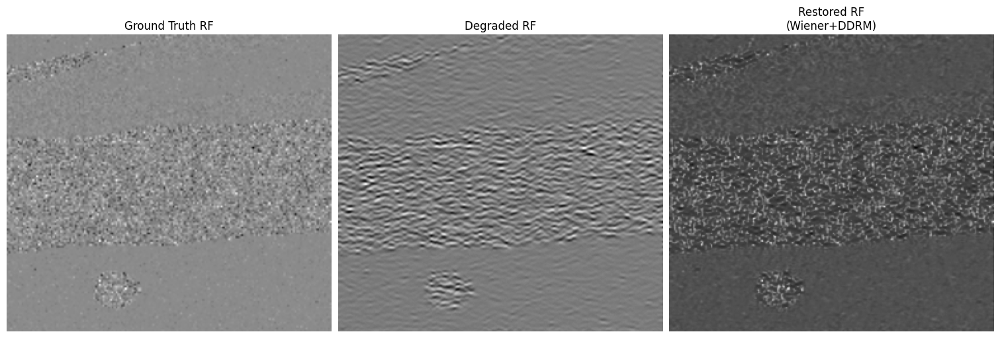

In [25]:
import scipy.io
import numpy as np
import matplotlib.pyplot as plt
import os

# 1. Paths to your .mat files
gt_path   = os.path.join("mat_Degradation", "ground_truth.mat")
deg_path  = os.path.join("mat_Degradation", "degraded_y0.mat")
rest_path = os.path.join("mat_Restore_DDRM_Wiener", "restored_ddrm.mat")

# 2. Load RF arrays
gt    = scipy.io.loadmat(gt_path)["GT_rf_resized"].squeeze()
deg   = scipy.io.loadmat(deg_path)["rf_degraded"].squeeze()
rest  = scipy.io.loadmat(rest_path)["rf_restored"].squeeze()

# 3. Normalize for fair visualization
def normalize(x):
    x = x.astype(np.float32)
    x -= x.min()
    x /= (x.max() - x.min() + 1e-8)
    return x

gt_n   = normalize(gt)
deg_n  = normalize(deg)
rest_n = normalize(rest)

# 4. Plot side by side
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
titles = ["Ground Truth RF", "Degraded RF", "Restored RF\n(Wiener+DDRM)"]

for ax, img, title in zip(axes, [gt_n, deg_n, rest_n], titles):
    ax.imshow(img, cmap="gray", aspect="auto")
    ax.set_title(title)
    ax.axis("off")

plt.show()


### noise 0.02;0.1,0.05

In [2]:
!python apply_degradation.py \
  --mat_dir  exp/datasets/anes_data/simu/2 \
  --mat_list exp/datasets/anes_data/simu/2/mat_list.txt \
  --key      GT_rf \
  --psf_path exp/datasets/anes_data/simu/2/psf_GT_2.mat \
  --image_size 256 \
  --sigma_0 0.05 \
  --output_dir mat_Restore_DDRM_ExtraNoise


Using device: cuda
✅ Found PSF key: psf_ref
✅ Saved:
   • ground_truth.mat   (GT_rf_resized)
   • degraded_y0.mat    (rf_degraded)


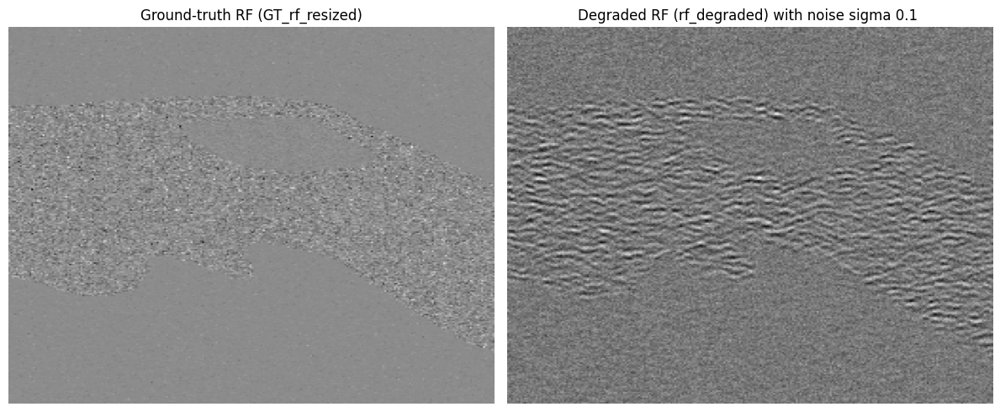

In [12]:
import scipy.io
import matplotlib.pyplot as plt
import numpy as np
import os

# ------------------------------------------------------------------
# 1.  Paths to the new .mat files
# ------------------------------------------------------------------
root_dir = "mat_Restore_DDRM_ExtraNoise"          # folder you chose when running apply_degradation.py
gt_path  = os.path.join(root_dir, "ground_truth.mat")
deg_path = os.path.join(root_dir, "degraded_y0.mat")

# ------------------------------------------------------------------
# 2.  Helper: load one variable from .mat
# ------------------------------------------------------------------
def load_var(mat_file, key):
    mat = scipy.io.loadmat(mat_file)
    if key not in mat:
        raise KeyError(f"'{key}' not found in {mat_file}")
    arr = mat[key]
    # if it ended up being 3-D (H, W, 1), squeeze to 2-D for display
    return arr.squeeze()

# ------------------------------------------------------------------
# 3.  Load arrays
# ------------------------------------------------------------------
gt_rf   = load_var(gt_path,  "GT_rf_resized")
deg_rf  = load_var(deg_path, "rf_degraded")

# ------------------------------------------------------------------
# 4.  Normalise to [0,1] for fair visual contrast
# ------------------------------------------------------------------
def normalise(img):
    img = img.astype(np.float32)
    img -= img.min()
    img /= (img.max() - img.min() + 1e-8)
    return img

gt_vis  = normalise(gt_rf)
deg_vis = normalise(deg_rf)

# ------------------------------------------------------------------
# 5.  Plot
# ------------------------------------------------------------------
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.imshow(gt_vis, cmap="gray", aspect="auto")
plt.title("Ground-truth RF (GT_rf_resized)")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(deg_vis, cmap="gray", aspect="auto")
plt.title("Degraded RF (rf_degraded) with noise sigma 0.1 ")
plt.axis("off")

plt.tight_layout()
plt.show()


In [13]:
!python run_ddrm_restoration.py \
  --degraded_mat  mat_Restore_DDRM_ExtraNoise/degraded_y0.mat \
  --gt_mat        mat_Restore_DDRM_ExtraNoise/ground_truth.mat \
  --psf_path      exp/datasets/anes_data/simu/2/psf_GT_2.mat \
  --model_path    exp/logs/imagenet/256x256_diffusion_uncond.pt \
  --config        deblur_us.yml \
  --timesteps     100 \
  --eta           0.9 \
  --etaB          1.0 \
  --sigma_0       0.1 \
  --output_dir    mat_Restore_DDRM_ExtraNoise


Module path: /projects/minds/PDAS-M2-2025/DDPM
Current sys.path: ['/projects/minds/PDAS-M2-2025/MIRDDRM', '/usr/lib/python310.zip', '/usr/lib/python3.10', '/usr/lib/python3.10/lib-dynload', '/home/pdas/.local/lib/python3.10/site-packages', '/usr/local/lib/python3.10/dist-packages', '/usr/local/lib/python3.10/dist-packages/nvfuser-0.1.4a0+d0bb811-py3.10-linux-x86_64.egg', '/usr/lib/python3/dist-packages', '/projects/minds/PDAS-M2-2025/DDPM']
File not found: /projects/minds/PDAS-M2-2025/DDPM/denoising_diffusion_pytorch.py
Import failed: No module named 'denoising_diffusion_pytorch'
Using device: cuda
✅ PSF loaded (key='psf_ref', shape=(11, 9))
INFO - main.py - 2025-05-19 13:33:19,979 - Using device: cuda
✅ Model checkpoint loaded
100it [00:43,  2.28it/s]
✅ Saved mat_Restore_DDRM_ExtraNoise/restored_ddrm.mat
PSNR: 26.43 dB   SSIM: 0.5645


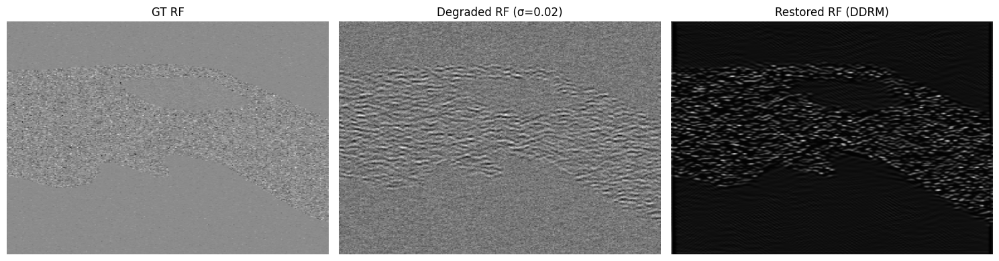

<Figure size 640x480 with 0 Axes>

In [14]:
import scipy.io, numpy as np, matplotlib.pyplot as plt

gt = scipy.io.loadmat("mat_Restore_DDRM_ExtraNoise/ground_truth.mat")["GT_rf_resized"]
deg = scipy.io.loadmat("mat_Restore_DDRM_ExtraNoise/degraded_y0.mat")["rf_degraded"]
rest = scipy.io.loadmat("mat_Restore_DDRM_ExtraNoise/restored_ddrm.mat")["rf_restored"]

def normalize(x):
    return (x - x.min()) / (x.max() - x.min() + 1e-8)

plt.figure(figsize=(15, 4))
for i, (img, title) in enumerate(zip(
    [normalize(gt), normalize(deg), normalize(rest)],
    ["GT RF", "Degraded RF (σ=0.02)", "Restored RF (DDRM)"])):
    plt.subplot(1, 3, i+1)
    plt.imshow(img, cmap="gray", aspect="auto")
    plt.title(title)
    plt.axis("off")
plt.tight_layout()
plt.show()
plt.savefig("mat_Restore_DDRM_ExtraNoise/rf_comparison_sigma005.png", dpi=300)


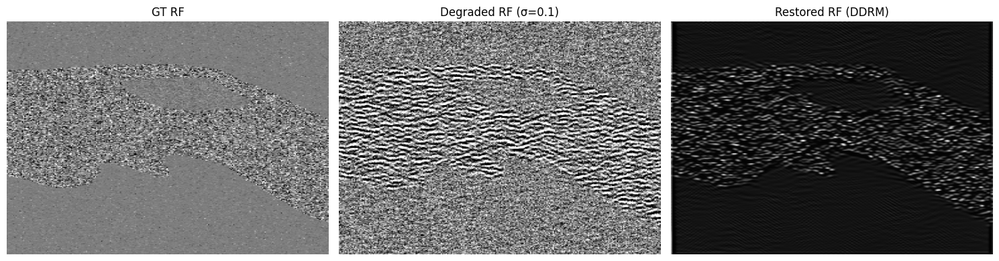

In [16]:
import scipy.io
import numpy as np
import matplotlib.pyplot as plt

# ------------------------------------------------------------------
# Load RF data
# ------------------------------------------------------------------
gt = scipy.io.loadmat("mat_Restore_DDRM_ExtraNoise/ground_truth.mat")["GT_rf_resized"]
deg = scipy.io.loadmat("mat_Restore_DDRM_ExtraNoise/degraded_y0.mat")["rf_degraded"]
rest = scipy.io.loadmat("mat_Restore_DDRM_ExtraNoise/restored_ddrm.mat")["rf_restored"]

# ------------------------------------------------------------------
# Normalize all images using percentiles from GT
# ------------------------------------------------------------------
def normalize_like_ref(x, ref, pmin=0.5, pmax=99.5):
    r_min, r_max = np.percentile(ref, [pmin, pmax])
    x = np.clip((x - r_min) / (r_max - r_min + 1e-8), 0, 1)
    return x

gt_norm   = normalize_like_ref(gt, gt)
deg_norm  = normalize_like_ref(deg, gt)
rest_norm = normalize_like_ref(rest, gt)

# ------------------------------------------------------------------
# Plot side-by-side comparison with consistent scaling
# ------------------------------------------------------------------
plt.figure(figsize=(15, 4))
titles = ["GT RF", "Degraded RF (σ=0.1)", "Restored RF (DDRM)"]
for i, (img, title) in enumerate(zip([gt_norm, deg_norm, rest_norm], titles)):
    plt.subplot(1, 3, i + 1)
    plt.imshow(img, cmap="gray", aspect="auto")
    plt.title(title)
    plt.axis("off")

plt.tight_layout()
plt.savefig("mat_Restore_DDRM_ExtraNoise/rf_comparison_normalized_sigma005.png", dpi=300)
plt.show()


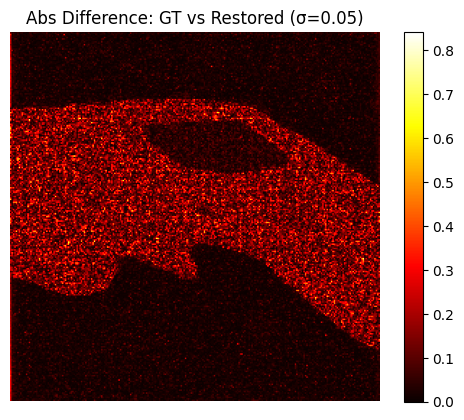

In [17]:
plt.imshow(np.abs(normalize_like_ref(gt, gt) - normalize_like_ref(rest, gt)), cmap='hot')
plt.title("Abs Difference: GT vs Restored (σ=0.05)")
plt.colorbar()
plt.axis('off')
plt.show()


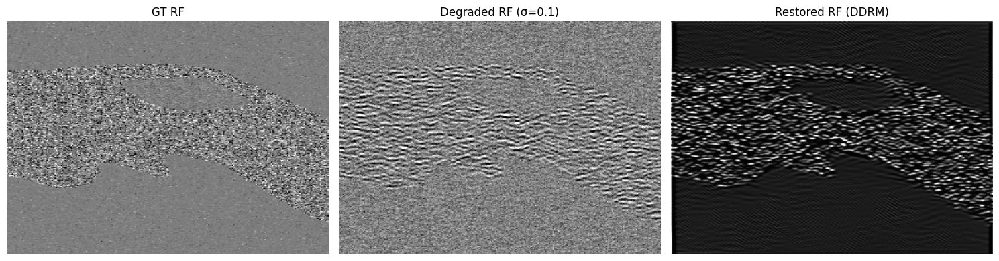

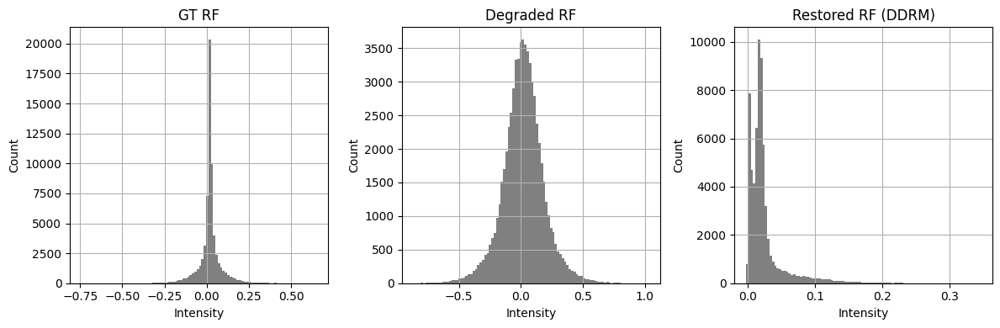

In [19]:
import numpy as np
import scipy.io
import matplotlib.pyplot as plt

# ----------------------------------
# Load RF Data
# ----------------------------------
gt    = scipy.io.loadmat("mat_Restore_DDRM_ExtraNoise/ground_truth.mat")["GT_rf_resized"]
deg   = scipy.io.loadmat("mat_Restore_DDRM_ExtraNoise/degraded_y0.mat")["rf_degraded"]
rest  = scipy.io.loadmat("mat_Restore_DDRM_ExtraNoise/restored_ddrm.mat")["rf_restored"]

# ----------------------------------
# Robust Normalization by self-percentiles
# ----------------------------------
def normalize_auto(x, pmin=0.5, pmax=99.5):
    vmin, vmax = np.percentile(x, [pmin, pmax])
    return np.clip((x - vmin) / (vmax - vmin + 1e-8), 0, 1)

gt_norm   = normalize_auto(gt)
deg_norm  = normalize_auto(deg)
rest_norm = normalize_auto(rest)

# ----------------------------------
# Side-by-side RF Visualization
# ----------------------------------
plt.figure(figsize=(15, 4))
titles = ["GT RF", "Degraded RF (σ=0.1)", "Restored RF (DDRM)"]
for i, (img, title) in enumerate(zip([gt_norm, deg_norm, rest_norm], titles)):
    plt.subplot(1, 3, i + 1)
    plt.imshow(img, cmap="gray", aspect="auto")
    plt.title(title)
    plt.axis("off")

plt.tight_layout()
plt.savefig("mat_Restore_DDRM_ExtraNoise/rf_comparison_normalized_auto.png", dpi=300)
plt.show()

# ----------------------------------
# Histogram of Raw Intensities
# ----------------------------------
plt.figure(figsize=(12, 4))
for i, (img, label) in enumerate(zip([gt, deg, rest], ["GT RF", "Degraded RF", "Restored RF (DDRM)"])):
    plt.subplot(1, 3, i+1)
    plt.hist(img.ravel(), bins=100, color='gray')
    plt.title(label)
    plt.xlabel("Intensity")
    plt.ylabel("Count")
    plt.grid(True)

plt.tight_layout()
plt.savefig("mat_Restore_DDRM_ExtraNoise/rf_histograms.png", dpi=300)
plt.show()


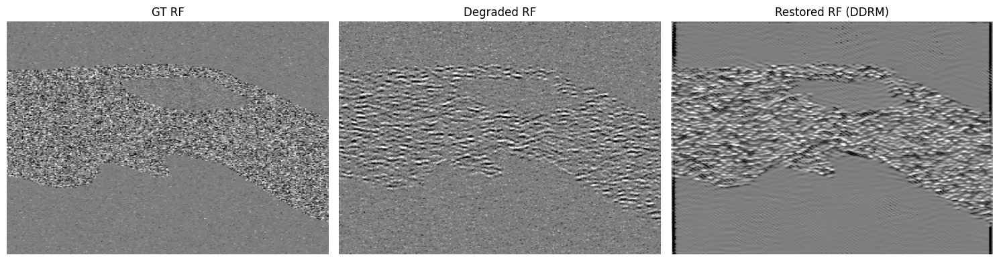

In [20]:
import numpy as np
import scipy.io
import matplotlib.pyplot as plt
from skimage.exposure import match_histograms

# -----------------------------
# 1. Load .mat files
# -----------------------------
gt      = scipy.io.loadmat("mat_Restore_DDRM_ExtraNoise/ground_truth.mat")["GT_rf_resized"]
deg     = scipy.io.loadmat("mat_Restore_DDRM_ExtraNoise/degraded_y0.mat")["rf_degraded"]
rest    = scipy.io.loadmat("mat_Restore_DDRM_ExtraNoise/restored_ddrm.mat")["rf_restored"]

# -----------------------------
# 2. Normalization Options
# -----------------------------
def normalize_percentile(x, pmin=0.5, pmax=99.5):
    """Normalize using image-specific percentiles."""
    vmin, vmax = np.percentile(x, [pmin, pmax])
    return np.clip((x - vmin) / (vmax - vmin + 1e-8), 0, 1)

def normalize_like_ref(x, ref, use_hist_match=True):
    """Histogram match to ref then normalize using ref percentiles."""
    if use_hist_match:
        x = match_histograms(x, ref, channel_axis=None)
    return normalize_percentile(x)

# -----------------------------
# 3. Apply Normalization
# -----------------------------
gt_norm   = normalize_percentile(gt)
deg_norm  = normalize_like_ref(deg, gt)
rest_norm = normalize_like_ref(rest, gt)

# -----------------------------
# 4. Plot
# -----------------------------
titles = ["GT RF", "Degraded RF", "Restored RF (DDRM)"]
images = [gt_norm, deg_norm, rest_norm]

plt.figure(figsize=(15, 4))
for i, (img, title) in enumerate(zip(images, titles)):
    plt.subplot(1, 3, i + 1)
    plt.imshow(img, cmap="gray", aspect="auto")
    plt.title(title)
    plt.axis("off")

plt.tight_layout()
plt.savefig("mat_Restore_DDRM_ExtraNoise/rf_comparison_auto_scaled.png", dpi=300)
plt.show()


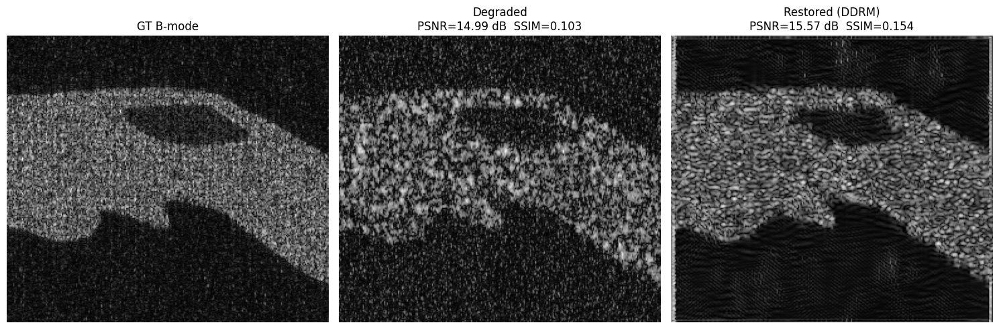

✅ B-mode images & comparison figure saved to mat_Restore_DDRM/


In [18]:
import numpy as np
import scipy.io
import matplotlib.pyplot as plt
from scipy.signal import hilbert
from skimage.exposure import match_histograms
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim
from pathlib import Path

# ---------------------------------------------------------------------
# 1. Reusable RF → B-mode converter that can skip / apply hist-matching
# ---------------------------------------------------------------------
def rf_to_bmode(
    rf: np.ndarray,
    ref_bmode: np.ndarray | None = None,
    dr_db: float = 60.0,
    eps: float = 1e-6,
) -> np.ndarray:
    """
    Convert RF → B-mode (uint8, 0-255). If ref_bmode is supplied,
    histogram-match the output to its intensity profile.
    """
    env = np.abs(hilbert(rf, axis=0))
    log = 20.0 * np.log10(env + eps)
    log = np.clip(log, -dr_db, None)

    # normalise to 0-255
    log -= log.min()
    log *= 255.0 / (log.max() + eps)

    if ref_bmode is not None:
        ref = ref_bmode[..., 0] if ref_bmode.ndim == 3 else ref_bmode
        log = match_histograms(log, ref, channel_axis=None)

    return np.clip(log, 0, 255).astype(np.uint8)


# ---------------------------------------------------------------------
# 2. Load the three RF images (GT, degraded, restored)
# ---------------------------------------------------------------------
paths = {
    "gt":        Path("mat_Restore_DDRM_ExtraNoise/ground_truth.mat"),
    "degraded":  Path("mat_Restore_DDRM_ExtraNoise/degraded_y0.mat"),
    "restored":  Path("mat_Restore_DDRM_ExtraNoise/restored_ddrm.mat"),
}

rf_gt        = scipy.io.loadmat(paths["gt"])       .get("GT_rf_resized")
rf_degraded  = scipy.io.loadmat(paths["degraded"]) .get("rf_degraded")
rf_restored  = scipy.io.loadmat(paths["restored"]) .get("rf_restored")

# ---------------------------------------------------------------------
# 3. Load Simu-1 ground-truth B-mode to use as reference
# ---------------------------------------------------------------------
bmode_GT = scipy.io.loadmat("exp/datasets/anes_data/simu/2/data.mat")["bmode_GT"]

# ---------------------------------------------------------------------
# 4. Optionally histogram-match RFs to GT-RF before envelope detection
#    (keeps fair scaling between degraded / restored)
# ---------------------------------------------------------------------
rf_degraded = match_histograms(rf_degraded, rf_gt, channel_axis=None)
rf_restored = match_histograms(rf_restored, rf_gt, channel_axis=None)

# ---------------------------------------------------------------------
# 5. Convert all three to B-mode with matching to Simu-1 GT B-mode
# ---------------------------------------------------------------------
b_gt   = rf_to_bmode(rf_gt,        ref_bmode=bmode_GT)
b_deg  = rf_to_bmode(rf_degraded,  ref_bmode=bmode_GT)
b_rest = rf_to_bmode(rf_restored,  ref_bmode=bmode_GT)

# ---------------------------------------------------------------------
# 6. Metrics (on uint8 B-mode for visual relevance)
# ---------------------------------------------------------------------
psnr_deg = psnr(b_gt, b_deg, data_range=255)
ssim_deg = ssim(b_gt, b_deg, data_range=255)

psnr_res = psnr(b_gt, b_rest, data_range=255)
ssim_res = ssim(b_gt, b_rest, data_range=255)

# ---------------------------------------------------------------------
# 7. Plot & save figure
# ---------------------------------------------------------------------
fig, ax = plt.subplots(1, 3, figsize=(15, 5))

titles = [
    "GT B-mode",
    f"Degraded\nPSNR={psnr_deg:.2f} dB  SSIM={ssim_deg:.3f}",
    f"Restored (DDRM)\nPSNR={psnr_res:.2f} dB  SSIM={ssim_res:.3f}",
]
for a, img, t in zip(ax, [b_gt, b_deg, b_rest], titles):
    a.imshow(img, cmap="gray", aspect="auto")
    a.set_title(t)
    a.axis("off")

plt.tight_layout()
fig.savefig("mat_Restore_DDRM_ExtraNoise/bmode_comparison.png", dpi=300, bbox_inches="tight")
plt.show()

# ---------------------------------------------------------------------
# 8. Save individual B-mode images for downstream use
# ---------------------------------------------------------------------
scipy.io.savemat("mat_Restore_DDRM_ExtraNoise/bmode_gt.mat",       {"bmode_gt": b_gt})
scipy.io.savemat("mat_Restore_DDRM_ExtraNoise/bmode_degraded.mat", {"bmode_degraded": b_deg})
scipy.io.savemat("mat_Restore_DDRM_ExtraNoise/bmode_restored.mat", {"bmode_restored": b_rest})

print("✅ B-mode images & comparison figure saved to mat_Restore_DDRM/")


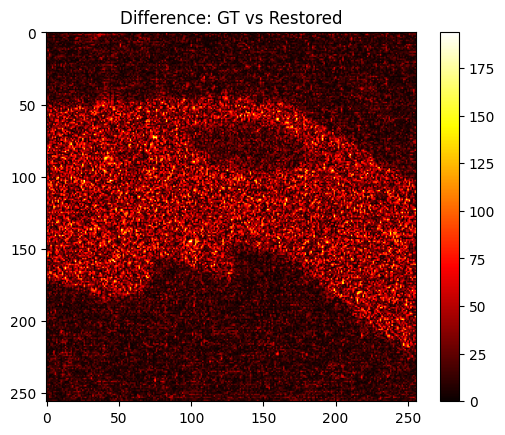

In [10]:
plt.imshow(np.abs(b_gt.astype(float) - b_rest.astype(float)), cmap='hot')
plt.title("Difference: GT vs Restored")
plt.colorbar()


### Resizing 

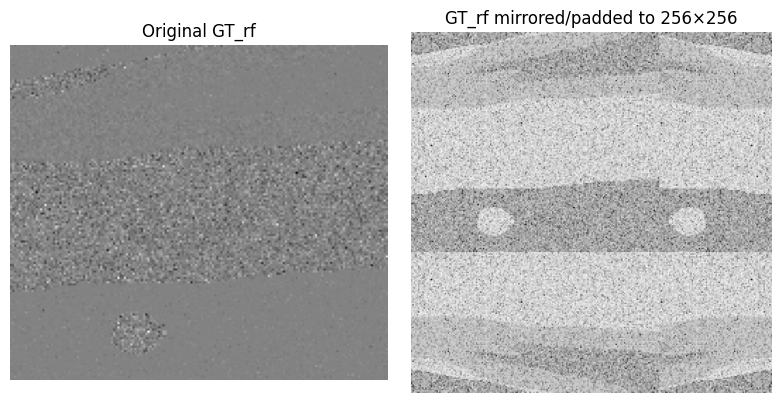

In [8]:
import scipy.io
import numpy as np
import matplotlib.pyplot as plt
import cv2

def mirror_pad_or_resize_to_256(data):
    h, w = data.shape
    if h > 256 or w > 256:
        return cv2.resize(data, (256, 256), interpolation=cv2.INTER_CUBIC).astype(data.dtype)
    result = np.zeros((256, 256), dtype=data.dtype)
    result[:h, :w] = data
    col = w
    while col < 256:
        width_to_fill = min(w, 256 - col)
        result[:h, col:col+width_to_fill] = np.fliplr(data[:, :width_to_fill])
        col += width_to_fill
    row = h
    while row < 256:
        height_to_fill = min(h, 256 - row)
        result[row:row+height_to_fill, :] = np.flipud(result[:height_to_fill, :])
        row += height_to_fill
    return result

# Load simu 1 data
simu1_path = "exp/datasets/anes_data/simu/1/data.mat"
data = scipy.io.loadmat(simu1_path)

# Apply to GT_rf only
gt_rf = data['GT_rf']
gt_rf_256 = mirror_pad_or_resize_to_256(gt_rf)

# Visualize
plt.figure(figsize=(8, 4))
plt.subplot(1, 2, 1)
plt.imshow(gt_rf, cmap='gray')
plt.title("Original GT_rf")
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(20 * np.log10(np.abs(gt_rf_256) + 1e-6), cmap='gray')
plt.title("GT_rf mirrored/padded to 256×256")
plt.axis('off')

plt.tight_layout()
plt.show()
scipy.io.savemat("GT_rf_256.mat", {"GT_rf_256": gt_rf_256})



In [5]:
!python apply_degradation_new.py \
  --mat_dir  exp/datasets/anes_data/simu/1 \
  --mat_list exp/datasets/anes_data/simu/1/mat_list.txt \
  --key      GT_rf \
  --psf_path exp/datasets/anes_data/simu/1/psf_GT_1.mat \
  --image_size 256 \
  --sigma_0 0.01 \
  --output_dir mat_output


Using device: cuda
✅ Found PSF key: psf_ref
✅ Saved:
   • ground_truth.mat   (GT_rf_resized)
   • degraded_y0.mat    (rf_degraded)


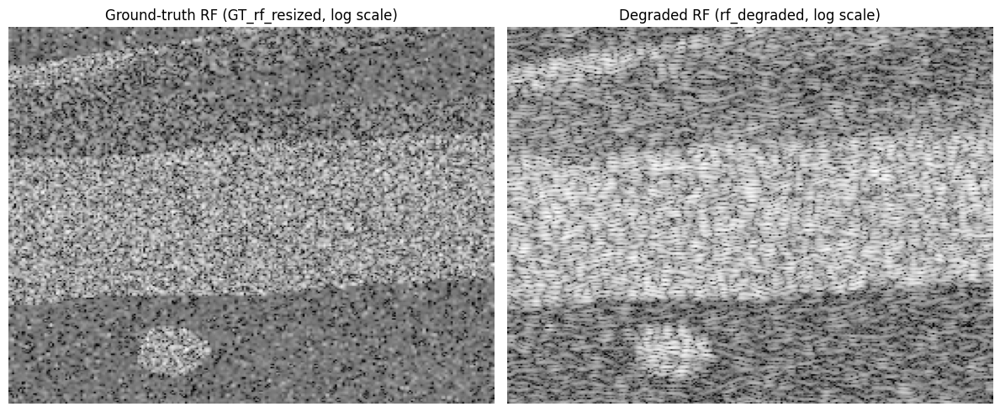

In [7]:
import scipy.io
import matplotlib.pyplot as plt
import numpy as np
import os

# ------------------------------------------------------------------
# 1.  Paths to the new .mat files
# ------------------------------------------------------------------
root_dir = "mat_output"          # <-- Set this to your output folder
gt_path  = os.path.join(root_dir, "ground_truth.mat")
deg_path = os.path.join(root_dir, "degraded_y0.mat")

# ------------------------------------------------------------------
# 2.  Helper: load one variable from .mat
# ------------------------------------------------------------------
def load_var(mat_file, key):
    mat = scipy.io.loadmat(mat_file)
    if key not in mat:
        raise KeyError(f"'{key}' not found in {mat_file}")
    arr = mat[key]
    return arr.squeeze()

# ------------------------------------------------------------------
# 3.  Load arrays
# ------------------------------------------------------------------
gt_rf   = load_var(gt_path,  "GT_rf_resized")
deg_rf  = load_var(deg_path, "rf_degraded")

# ------------------------------------------------------------------
# 4.  Normalize or log-compress for fair visual contrast
# ------------------------------------------------------------------
def log_compress(img, db_min=-60):
    env = np.abs(img)
    db = 20 * np.log10(env + 1e-6)
    db = np.clip(db, db_min, None)
    db -= db.min()
    db /= (db.max() + 1e-8)
    return db

gt_vis  = log_compress(gt_rf)
deg_vis = log_compress(deg_rf)

# ------------------------------------------------------------------
# 5.  Plot
# ------------------------------------------------------------------
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.imshow(gt_vis, cmap="gray", aspect="auto")
plt.title("Ground-truth RF (GT_rf_resized, log scale)")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(deg_vis, cmap="gray", aspect="auto")
plt.title("Degraded RF (rf_degraded, log scale)")
plt.axis("off")

plt.tight_layout()
plt.show()


In [9]:
!python apply_degradation_new.py \
  --mat_dir  exp/datasets/anes_data/simu/1 \
  --mat_list exp/datasets/anes_data/simu/1/mat_list.txt \
  --key      GT_rf \
  --psf_path exp/datasets/anes_data/simu/1/psf_GT_1.mat \
  --image_size 256 \
  --sigma_0 0.01 \
  --output_dir mat_output


Using device: cuda
✅ Found PSF key: psf_ref
✅ Saved:
   • ground_truth.mat   (GT_rf_resized)
   • degraded_y0.mat    (rf_degraded)


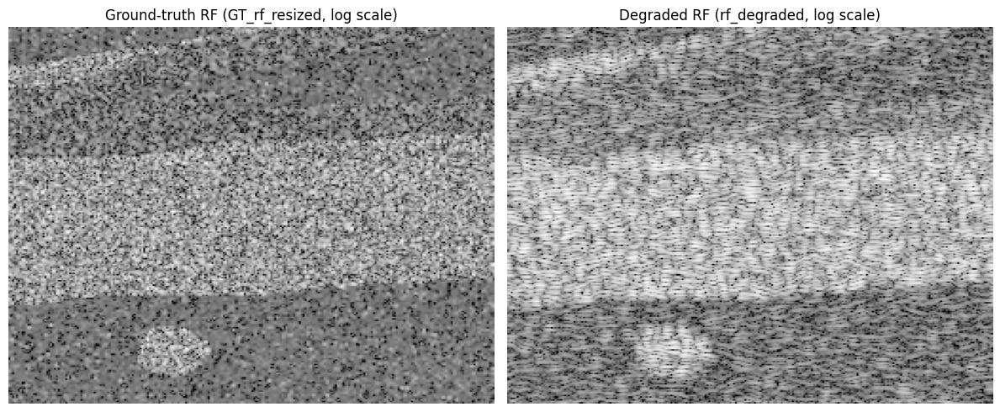

In [10]:
import scipy.io
import numpy as np
import matplotlib.pyplot as plt
import os

# Paths to output files
root_dir = "mat_output"
gt_path  = os.path.join(root_dir, "ground_truth.mat")
deg_path = os.path.join(root_dir, "degraded_y0.mat")

# Helper: Load variable from .mat
def load_var(mat_file, key):
    mat = scipy.io.loadmat(mat_file)
    if key not in mat:
        raise KeyError(f"'{key}' not found in {mat_file}")
    arr = mat[key]
    return arr.squeeze()

# Load arrays
gt_rf   = load_var(gt_path,  "GT_rf_resized")
deg_rf  = load_var(deg_path, "rf_degraded")

# Log-compress for display (ultrasound style)
def log_compress(img, db_min=-60):
    env = np.abs(img)
    db = 20 * np.log10(env + 1e-6)
    db = np.clip(db, db_min, None)
    db -= db.min()
    db /= (db.max() + 1e-8)
    return db

gt_vis  = log_compress(gt_rf)
deg_vis = log_compress(deg_rf)

# Plot
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.imshow(gt_vis, cmap="gray", aspect="auto")
plt.title("Ground-truth RF (GT_rf_resized, log scale)")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(deg_vis, cmap="gray", aspect="auto")
plt.title("Degraded RF (rf_degraded, log scale)")
plt.axis("off")

plt.tight_layout()
plt.show()


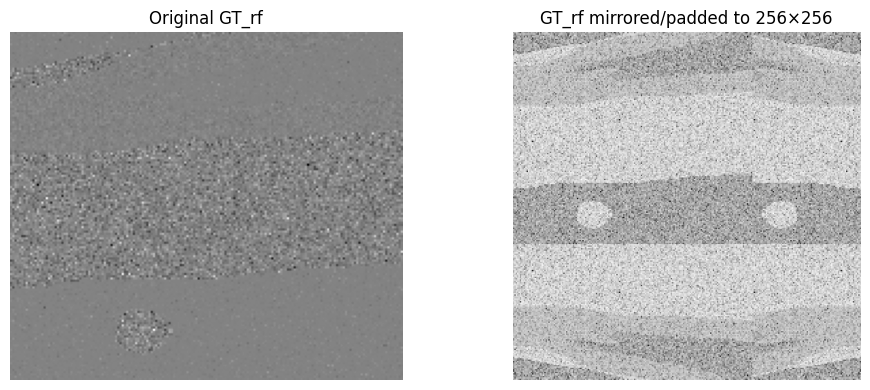

In [11]:
import scipy.io
import numpy as np
import matplotlib.pyplot as plt
import cv2

def mirror_pad_or_resize_to_256(data):
    h, w = data.shape
    if h > 256 or w > 256:
        return cv2.resize(data, (256, 256), interpolation=cv2.INTER_CUBIC).astype(data.dtype)
    result = np.zeros((256, 256), dtype=data.dtype)
    result[:h, :w] = data
    col = w
    while col < 256:
        width_to_fill = min(w, 256 - col)
        result[:h, col:col+width_to_fill] = np.fliplr(data[:, :width_to_fill])
        col += width_to_fill
    row = h
    while row < 256:
        height_to_fill = min(h, 256 - row)
        result[row:row+height_to_fill, :] = np.flipud(result[:height_to_fill, :])
        row += height_to_fill
    return result

# Load original GT_rf from simu 1 data
simu1_path = "exp/datasets/anes_data/simu/1/data.mat"   # Change if needed
data = scipy.io.loadmat(simu1_path)
gt_rf = data['GT_rf']   # Shape (156, 176)

# Apply mirrored/padded resizing
gt_rf_256 = mirror_pad_or_resize_to_256(gt_rf)

# Visualize
plt.figure(figsize=(10, 4))
plt.subplot(1, 2, 1)
plt.imshow(gt_rf, cmap='gray')
plt.title("Original GT_rf")
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(20 * np.log10(np.abs(gt_rf_256) + 1e-6), cmap='gray')
plt.title("GT_rf mirrored/padded to 256×256")
plt.axis('off')
plt.tight_layout()
plt.show()

# Save the resized GT_rf if needed
scipy.io.savemat("GT_rf_256_mirrored.mat", {"GT_rf_256": gt_rf_256})


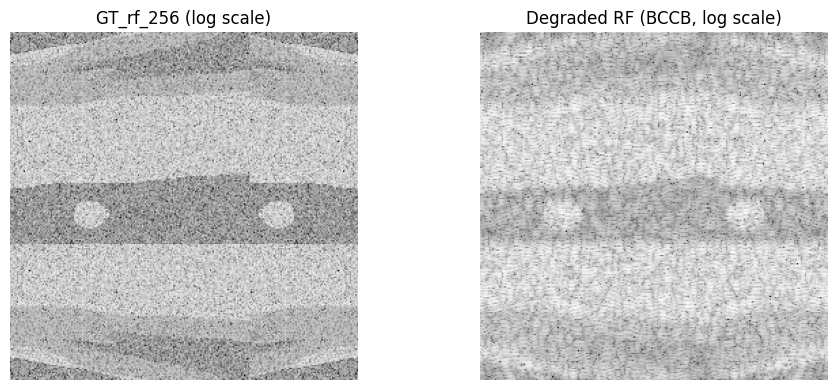

In [4]:
import torch
import scipy.io
import numpy as np

# =============================================
# ✅ Simple FFT-based BCCB Convolution Class
# =============================================
class BCCBConv:
    def __init__(self, psf, shape, device):
        """
        psf: 2D numpy array (Mh×Nh)
        shape: (H, W) target RF image shape
        """
        self.device = device
        H, W = shape
        Mh, Nh = psf.shape

        # 1) Zero-pad the PSF to (H, W)
        padded = np.zeros((H, W), dtype=np.float32)
        padded[:Mh, :Nh] = psf

        # 2) Center the PSF (roll so that its center is at (0,0))
        center = (Mh//2, Nh//2)
        shifted = np.roll(np.roll(padded, -center[0], axis=0),
                          -center[1], axis=1)

        # 3) Precompute FFT of PSF
        psf_tensor = torch.tensor(shifted, dtype=torch.float32, device=device)
        self.H_fft = torch.fft.rfftn(psf_tensor, s=(H, W))

    def H(self, x):
        """
        x: torch tensor of shape (B, C, H, W), real-valued
        returns: torch tensor (B, C, H, W), real-valued
        """
        # Compute FFT along last two dims
        X_fft = torch.fft.rfftn(x, dim=(-2, -1))
        # Multiply in freq domain (broadcast over C)
        Y_fft = X_fft * self.H_fft[None, None, ...]
        # Inverse FFT back to spatial
        y = torch.fft.irfftn(Y_fft, s=x.shape[-2:], dim=(-2, -1))
        return y.real


# 1. Load GT_rf_256 and PSF
gt_rf_256 = scipy.io.loadmat("GT_rf_256_mirrored.mat")["GT_rf_256"]
psf = scipy.io.loadmat("exp/datasets/anes_data/simu/1/psf_GT_1.mat")["psf_ref"]  # or PSF_estim

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# 2. Convert GT_rf_256 to torch tensor, batch and channel dim
x = torch.tensor(gt_rf_256, dtype=torch.float32, device=device).unsqueeze(0).unsqueeze(0)  # (1, 1, 256, 256)

# 3. Instantiate BCCBConv
conv = BCCBConv(psf, shape=(256, 256), device=device)

# 4. Apply PSF degradation
y = conv.H(x)  # (1, 1, 256, 256)

# 5. Add Gaussian noise
sigma_0 = 0.02
y_noisy = y + sigma_0 * torch.randn_like(y)

# 6. Convert back to numpy for saving/visualization
y_np = y_noisy[0, 0].cpu().numpy()

# 7. Save as .mat
scipy.io.savemat("rf_degraded_bccb.mat", {"rf_degraded": y_np})

# 8. Visualize (log-compressed)
import matplotlib.pyplot as plt
def log_compress(img, db_min=-60):
    env = np.abs(img)
    db = 20 * np.log10(env + 1e-6)
    db = np.clip(db, db_min, None)
    db -= db.min()
    db /= (db.max() + 1e-8)
    return db

plt.figure(figsize=(10, 4))
plt.subplot(1, 2, 1)
plt.imshow(log_compress(gt_rf_256), cmap="gray")
plt.title("GT_rf_256 (log scale)")
plt.axis("off")
plt.subplot(1, 2, 2)
plt.imshow(log_compress(y_np), cmap="gray")
plt.title("Degraded RF (BCCB, log scale)")
plt.axis("off")
plt.tight_layout()
plt.show()


In [6]:
import os
import scipy.io

# Make sure the directory exists
output_dir = "input/Degraded_Resized"
os.makedirs(output_dir, exist_ok=True)

# Save the degraded RF output as .mat in the desired folder
save_path = os.path.join(output_dir, "rf_degraded_bccb.mat")
scipy.io.savemat(save_path, {"rf_degraded": y_np})
print(f"Degraded output saved at: {save_path}")


Degraded output saved at: input/Degraded_Resized/rf_degraded_bccb.mat


In [7]:
import scipy.io

# Check rf_degraded_bccb.mat
rf_data = scipy.io.loadmat("input/Degraded_Resized/rf_degraded_bccb.mat")
print("rf_degraded_bccb.mat variables and shapes:")
for k, v in rf_data.items():
    if not k.startswith("__"):
        print(f"  {k}: {v.shape}")

# Check GT_rf_256_mirrored.mat
gt_data = scipy.io.loadmat("input/GT_rf_256_mirrored.mat")
print("\nGT_rf_256_mirrored.mat variables and shapes:")
for k, v in gt_data.items():
    if not k.startswith("__"):
        print(f"  {k}: {v.shape}")


rf_degraded_bccb.mat variables and shapes:
  rf_degraded: (256, 256)

GT_rf_256_mirrored.mat variables and shapes:
  GT_rf_256: (256, 256)


In [8]:
import scipy.io
gt = scipy.io.loadmat("input/GT_rf_256_mirrored.mat")["GT_rf_256"]
scipy.io.savemat("input/GT_rf_256_mirrored.mat", {"GT_rf_resized": gt})


In [9]:
!python run_ddrm_restoration.py \
  --degraded_mat  input/Degraded_Resized/rf_degraded_bccb.mat \
  --gt_mat        input/GT_rf_256_mirrored.mat \
  --psf_path      exp/datasets/anes_data/simu/1/psf_GT_1.mat \
  --model_path    exp/logs/imagenet/256x256_diffusion_uncond.pt \
  --config        deblur_us.yml \
  --timesteps     100 \
  --eta           0.9 \
  --etaB          1.0 \
  --sigma_0       0.02 \
  --output_dir    input/Degraded_Resized


Module path: /projects/minds/PDAS-M2-2025/DDPM
Current sys.path: ['/projects/minds/PDAS-M2-2025/MIRDDRM', '/usr/lib/python310.zip', '/usr/lib/python3.10', '/usr/lib/python3.10/lib-dynload', '/home/pdas/.local/lib/python3.10/site-packages', '/usr/local/lib/python3.10/dist-packages', '/usr/local/lib/python3.10/dist-packages/nvfuser-0.1.4a0+d0bb811-py3.10-linux-x86_64.egg', '/usr/lib/python3/dist-packages', '/projects/minds/PDAS-M2-2025/DDPM']
File not found: /projects/minds/PDAS-M2-2025/DDPM/denoising_diffusion_pytorch.py
Import failed: No module named 'denoising_diffusion_pytorch'
Using device: cuda
✅ PSF loaded (key='psf_ref', shape=(11, 9))
INFO - main.py - 2025-05-19 16:03:06,231 - Using device: cuda
✅ Model checkpoint loaded
100it [00:44,  2.24it/s]
✅ Saved input/Degraded_Resized/restored_ddrm.mat
PSNR: 12.59 dB   SSIM: 0.0698
